In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import datetime
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_absolute_error


from prophet import Prophet
from xgboost import XGBRegressor

In [2]:
pip install darts


                                              0.0/693.9 kB ? eta -:--:--
     ------                                 112.6/693.9 kB 3.3 MB/s eta 0:00:01
     ------------------------               440.3/693.9 kB 5.5 MB/s eta 0:00:01
     -------------------------------------- 693.9/693.9 kB 6.3 MB/s eta 0:00:00
                                              0.0/153.4 kB ? eta -:--:--
     ---------------------------------------- 153.4/153.4 kB ? eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
                                              0.0/462.3 kB ? eta -:--:--
     ---------------------------------------- 462.3/462.3 kB ? eta 0:00:00
                                              0.0/100.0 kB ? eta -:--:--
     ---------------------------------------- 100.0/100.0 kB ? eta 0:00:00
                                              0.0/44.0 kB ? eta -:--:--
     ---------------------------------------- 44.0/44.0 kB ? eta 0:0

In [80]:
df1=pd.read_csv('C:/eaglei_outages/eaglei_outages/eaglei_outages_2014.csv')

In [44]:
df2 = pd.read_csv('C:/eaglei_outages/eaglei_outages/eaglei_outages_2015.csv')

In [5]:
df3 = pd.read_csv('C:/eaglei_outages/eaglei_outages/eaglei_outages_2016.csv')

In [6]:
df4 = pd.read_csv('C:/eaglei_outages/eaglei_outages/eaglei_outages_2017.csv')

In [7]:
df5 =  pd.read_csv('C:/eaglei_outages/eaglei_outages/eaglei_outages_2018.csv')

In [8]:
df6 = pd.read_csv('C:/eaglei_outages/eaglei_outages/eaglei_outages_2019.csv')

In [9]:
df7 = pd.read_csv('C:/eaglei_outages/eaglei_outages/eaglei_outages_2020.csv')

In [10]:
df8 =pd.read_csv('C:/eaglei_outages/eaglei_outages/eaglei_outages_2021.csv')

In [11]:
df9 = pd.read_csv('C:/eaglei_outages/eaglei_outages/eaglei_outages_2022.csv')

In [13]:
df1['hour'] = df1.index.strftime('%H:%M:%S')

In [14]:
df1['date'] = df1.index.date

In [15]:
df1.head()

,fips_code,county,state,sum,hour,date
run_start_time,,,,,,
2014-11-01 04:00:00,1037,Coosa,Alabama,12,04:00:00,2014-11-01
2014-11-01 04:00:00,1051,Elmore,Alabama,7,04:00:00,2014-11-01
2014-11-01 04:00:00,1109,Pike,Alabama,1,04:00:00,2014-11-01
2014-11-01 04:00:00,1121,Talladega,Alabama,31,04:00:00,2014-11-01
2014-11-01 04:00:00,4017,Navajo,Arizona,1,04:00:00,2014-11-01


In [81]:
sandiego_df1 = df1[(df1['fips_code'] == 6073) & (df1['county'] == 'San Diego')]

In [82]:
sandiego_df1

,fips_code,county,state,sum,run_start_time
2893,6073,San Diego,California,377,2014-11-01 06:30:00
8603,6073,San Diego,California,130,2014-11-01 11:15:00
8944,6073,San Diego,California,3191,2014-11-01 11:30:00
9305,6073,San Diego,California,3191,2014-11-01 11:45:00
9677,6073,San Diego,California,3191,2014-11-01 12:00:00
...,...,...,...,...,...
1688049,6073,San Diego,California,134,2014-12-30 23:00:00
1688346,6073,San Diego,California,1593,2014-12-30 23:15:00
1688631,6073,San Diego,California,1593,2014-12-30 23:30:00
1688912,6073,San Diego,California,1593,2014-12-30 23:45:00


In [83]:
# Convert run_start_time to datetime format
sandiego_df1['run_start_time'] = pd.to_datetime(sandiego_df1['run_start_time'])

# Set the run_start_time column as the DataFrame index
sandiego_df1.set_index('run_start_time', inplace=True)

C:\Users\halee\AppData\Local\Temp\ipykernel_24392\1902342349.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sandiego_df1['run_start_time'] = pd.to_datetime(sandiego_df1['run_start_time'])


In [84]:
sandiego_df1

,fips_code,county,state,sum
run_start_time,,,,
2014-11-01 06:30:00,6073,San Diego,California,377
2014-11-01 11:15:00,6073,San Diego,California,130
2014-11-01 11:30:00,6073,San Diego,California,3191
2014-11-01 11:45:00,6073,San Diego,California,3191
2014-11-01 12:00:00,6073,San Diego,California,3191
...,...,...,...,...
2014-12-30 23:00:00,6073,San Diego,California,134
2014-12-30 23:15:00,6073,San Diego,California,1593
2014-12-30 23:30:00,6073,San Diego,California,1593


In [85]:
# Group by county FIPS code and run start time, and apply hourly sum
hourly_sum_df1 = sandiego_df1.groupby(['county', pd.Grouper(freq='H')]).sum(numeric_only=True)

# Reset index to get county FIPS code and run start time as columns
hourly_sum_df1 = sandiego_df1.reset_index()

# Rename the sum column to 'hourly_sum'
hourly_sum_df1 = sandiego_df1.rename(columns={'sum': 'hourly_sum'})

In [86]:
hourly_sum_df1

,fips_code,county,state,hourly_sum
run_start_time,,,,
2014-11-01 06:30:00,6073,San Diego,California,377
2014-11-01 11:15:00,6073,San Diego,California,130
2014-11-01 11:30:00,6073,San Diego,California,3191
2014-11-01 11:45:00,6073,San Diego,California,3191
2014-11-01 12:00:00,6073,San Diego,California,3191
...,...,...,...,...
2014-12-30 23:00:00,6073,San Diego,California,134
2014-12-30 23:15:00,6073,San Diego,California,1593
2014-12-30 23:30:00,6073,San Diego,California,1593


In [87]:
hourly_sum_df1.drop(columns=['county','fips_code','state'], inplace=True)

In [88]:
hourly_sum_df1

,hourly_sum
run_start_time,
2014-11-01 06:30:00,377
2014-11-01 11:15:00,130
2014-11-01 11:30:00,3191
2014-11-01 11:45:00,3191
2014-11-01 12:00:00,3191
...,...
2014-12-30 23:00:00,134
2014-12-30 23:15:00,1593
2014-12-30 23:30:00,1593


In [45]:
sandiego_df2 = df2[(df2['fips_code'] == 6073) & (df2['county'] == 'San Diego')]

In [324]:
sandiego_df2 

,fips_code,county,state,sum
run_start_time,,,,
2015-01-01 05:45:00,6073,San Diego,California,126
2015-01-01 06:00:00,6073,San Diego,California,126
2015-01-01 06:15:00,6073,San Diego,California,126
2015-01-01 06:30:00,6073,San Diego,California,126
2015-01-01 06:45:00,6073,San Diego,California,126
...,...,...,...,...
2015-12-30 23:00:00,6073,San Diego,California,112
2015-12-30 23:15:00,6073,San Diego,California,112
2015-12-30 23:30:00,6073,San Diego,California,112


In [63]:
sandiego_df2 = df2[(df2['fips_code'] == 6073) & (df2['county'] == 'San Diego')]

,fips_code,county,state,sum
run_start_time,,,,
2015-01-01 05:45:00,6073,San Diego,California,126
2015-01-01 06:00:00,6073,San Diego,California,126
2015-01-01 06:15:00,6073,San Diego,California,126
2015-01-01 06:30:00,6073,San Diego,California,126
2015-01-01 06:45:00,6073,San Diego,California,126
...,...,...,...,...
2015-12-30 23:00:00,6073,San Diego,California,112
2015-12-30 23:15:00,6073,San Diego,California,112
2015-12-30 23:30:00,6073,San Diego,California,112


In [48]:
# Convert run_start_time to datetime format
sandiego_df2['run_start_time'] = pd.to_datetime(sandiego_df2['run_start_time'])

# Set the run_start_time column as the DataFrame index
sandiego_df2.set_index('run_start_time', inplace=True)

C:\Users\halee\AppData\Local\Temp\ipykernel_24392\4224898449.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sandiego_df2['run_start_time'] = pd.to_datetime(sandiego_df2['run_start_time'])


In [64]:
# Group by county FIPS code and run start time, and apply hourly sum
hourly_sum_df2 = sandiego_df2.groupby(['county', pd.Grouper(freq='H')]).sum(numeric_only=True)

# Reset index to get county FIPS code and run start time as columns
hourly_sum_df2 = hourly_sum_df2.reset_index()

# Rename the sum column to 'hourly_sum'
hourly_sum_df2 = hourly_sum_df2.rename(columns={'sum': 'hourly_sum'})

In [66]:
hourly_sum_df2.head()

,county,run_start_time,fips_code,hourly_sum
0,San Diego,2015-01-01 05:00:00,6073,126
1,San Diego,2015-01-01 06:00:00,24292,504
2,San Diego,2015-01-01 07:00:00,6073,2
3,San Diego,2015-01-01 12:00:00,24292,6331
4,San Diego,2015-01-01 13:00:00,24292,5252


In [67]:
hourly_sum_df2.drop(columns=['county','fips_code'], inplace=True)

In [68]:
hourly_sum_df2

,run_start_time,hourly_sum
0,2015-01-01 05:00:00,126
1,2015-01-01 06:00:00,504
2,2015-01-01 07:00:00,2
3,2015-01-01 12:00:00,6331
4,2015-01-01 13:00:00,5252
...,...,...
7756,2015-12-30 20:00:00,700
7757,2015-12-30 21:00:00,535
7758,2015-12-30 22:00:00,549
7759,2015-12-30 23:00:00,448


In [89]:
sandiego_df3 = df3[(df3['fips_code'] == 6073) & (df3['county'] == 'San Diego')]

In [90]:
sandiego_df3

,fips_code,county,state,sum,run_start_time
19608,6073,San Diego,California,1,2016-01-01 18:15:00
19989,6073,San Diego,California,1,2016-01-01 18:30:00
20375,6073,San Diego,California,1,2016-01-01 18:45:00
20762,6073,San Diego,California,1,2016-01-01 19:00:00
21142,6073,San Diego,California,1,2016-01-01 19:15:00
...,...,...,...,...,...
13300574,6073,San Diego,California,20,2016-12-30 20:15:00
13300960,6073,San Diego,California,20,2016-12-30 20:30:00
13301345,6073,San Diego,California,20,2016-12-30 20:45:00
13301737,6073,San Diego,California,20,2016-12-30 21:00:00


In [91]:
# Convert run_start_time to datetime format
sandiego_df3['run_start_time'] = pd.to_datetime(sandiego_df3['run_start_time'])

# Set the run_start_time column as the DataFrame index
sandiego_df3.set_index('run_start_time', inplace=True)

C:\Users\halee\AppData\Local\Temp\ipykernel_24392\3611938441.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sandiego_df3['run_start_time'] = pd.to_datetime(sandiego_df3['run_start_time'])


In [92]:
# Group by county FIPS code and run start time, and apply hourly sum
hourly_sum_df3 = sandiego_df3.groupby(['county', pd.Grouper(freq='H')]).sum(numeric_only=True)

# Reset index to get county FIPS code and run start time as columns
hourly_sum_df3 = hourly_sum_df3.reset_index()

# Rename the sum column to 'hourly_sum'
hourly_sum_df3 = hourly_sum_df3.rename(columns={'sum': 'hourly_sum'})

In [94]:
hourly_sum_df3.head()

,county,run_start_time,fips_code,hourly_sum
0,San Diego,2016-01-01 18:00:00,18219,3
1,San Diego,2016-01-01 19:00:00,24292,4
2,San Diego,2016-01-01 20:00:00,24292,4
3,San Diego,2016-01-01 21:00:00,24292,4
4,San Diego,2016-01-01 22:00:00,24292,5688


In [95]:
hourly_sum_df3.drop(columns=['county','fips_code'], inplace=True)

In [96]:
hourly_sum_df3

,run_start_time,hourly_sum
0,2016-01-01 18:00:00,3
1,2016-01-01 19:00:00,4
2,2016-01-01 20:00:00,4
3,2016-01-01 21:00:00,4
4,2016-01-01 22:00:00,5688
...,...,...
8008,2016-12-30 17:00:00,1637
8009,2016-12-30 18:00:00,2602
8010,2016-12-30 19:00:00,126
8011,2016-12-30 20:00:00,80


In [97]:
sandiego_df1 = df1[(df1['fips_code'] == 6073) & (df1['county'] == 'San Diego')]

In [98]:
sandiego_df1

,fips_code,county,state,sum,run_start_time
2893,6073,San Diego,California,377,2014-11-01 06:30:00
8603,6073,San Diego,California,130,2014-11-01 11:15:00
8944,6073,San Diego,California,3191,2014-11-01 11:30:00
9305,6073,San Diego,California,3191,2014-11-01 11:45:00
9677,6073,San Diego,California,3191,2014-11-01 12:00:00
...,...,...,...,...,...
1688049,6073,San Diego,California,134,2014-12-30 23:00:00
1688346,6073,San Diego,California,1593,2014-12-30 23:15:00
1688631,6073,San Diego,California,1593,2014-12-30 23:30:00
1688912,6073,San Diego,California,1593,2014-12-30 23:45:00


In [99]:
# Convert run_start_time to datetime format
sandiego_df1['run_start_time'] = pd.to_datetime(sandiego_df1['run_start_time'])

# Set the run_start_time column as the DataFrame index
sandiego_df1.set_index('run_start_time', inplace=True)

C:\Users\halee\AppData\Local\Temp\ipykernel_24392\1902342349.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sandiego_df1['run_start_time'] = pd.to_datetime(sandiego_df1['run_start_time'])


In [100]:
# Group by county FIPS code and run start time, and apply hourly sum
hourly_sum_df1 = sandiego_df1.groupby(['county', pd.Grouper(freq='H')]).sum(numeric_only=True)

# Reset index to get county FIPS code and run start time as columns
hourly_sum_df1 = hourly_sum_df1.reset_index()

# Rename the sum column to 'hourly_sum'
hourly_sum_df1 = hourly_sum_df1.rename(columns={'sum': 'hourly_sum'})

In [101]:
hourly_sum_df1.head()

,county,run_start_time,fips_code,hourly_sum
0,San Diego,2014-11-01 06:00:00,6073,377
1,San Diego,2014-11-01 11:00:00,18219,6512
2,San Diego,2014-11-01 12:00:00,24292,11202
3,San Diego,2014-11-01 13:00:00,24292,7719
4,San Diego,2014-11-01 14:00:00,24292,3458


In [102]:
hourly_sum_df1.drop(columns=['county','fips_code'], inplace=True)

In [103]:
hourly_sum_df1

,run_start_time,hourly_sum
0,2014-11-01 06:00:00,377
1,2014-11-01 11:00:00,6512
2,2014-11-01 12:00:00,11202
3,2014-11-01 13:00:00,7719
4,2014-11-01 14:00:00,3458
...,...,...
1218,2014-12-30 20:00:00,717
1219,2014-12-30 21:00:00,622
1220,2014-12-30 22:00:00,536
1221,2014-12-30 23:00:00,4913


In [104]:
sandiego_df4 = df4[(df4['fips_code'] == 6073) & (df4['county'] == 'San Diego')]

In [105]:
sandiego_df4

,fips_code,county,state,sum,run_start_time
11,6073,San Diego,California,151.0,2017-01-01 00:00:00
272,6073,San Diego,California,151.0,2017-01-01 00:15:00
532,6073,San Diego,California,151.0,2017-01-01 00:30:00
781,6073,San Diego,California,412.0,2017-01-01 00:45:00
1021,6073,San Diego,California,2516.0,2017-01-01 01:00:00
...,...,...,...,...,...
15076316,6073,San Diego,California,1.0,2017-12-30 23:00:00
15076740,6073,San Diego,California,1.0,2017-12-30 23:15:00
15077156,6073,San Diego,California,1.0,2017-12-30 23:30:00
15077562,6073,San Diego,California,1.0,2017-12-30 23:45:00


In [106]:
# Convert run_start_time to datetime format
sandiego_df4['run_start_time'] = pd.to_datetime(sandiego_df4['run_start_time'])

# Set the run_start_time column as the DataFrame index
sandiego_df4.set_index('run_start_time', inplace=True)

C:\Users\halee\AppData\Local\Temp\ipykernel_24392\3543013722.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sandiego_df4['run_start_time'] = pd.to_datetime(sandiego_df4['run_start_time'])


In [107]:
# Group by county FIPS code and run start time, and apply hourly sum
hourly_sum_df4 = sandiego_df4.groupby(['county', pd.Grouper(freq='H')]).sum(numeric_only=True)

# Reset index to get county FIPS code and run start time as columns
hourly_sum_df4 = hourly_sum_df4.reset_index()

# Rename the sum column to 'hourly_sum'
hourly_sum_df4 = hourly_sum_df4.rename(columns={'sum': 'hourly_sum'})

In [108]:
hourly_sum_df4.head()

,county,run_start_time,fips_code,hourly_sum
0,San Diego,2017-01-01 00:00:00,24292,865.0
1,San Diego,2017-01-01 01:00:00,24292,8089.0
2,San Diego,2017-01-01 02:00:00,24292,5282.0
3,San Diego,2017-01-01 03:00:00,24292,4014.0
4,San Diego,2017-01-01 04:00:00,24292,852.0


In [109]:
hourly_sum_df4.drop(columns=['county','fips_code'], inplace=True)

In [110]:
hourly_sum_df4

,run_start_time,hourly_sum
0,2017-01-01 00:00:00,865.0
1,2017-01-01 01:00:00,8089.0
2,2017-01-01 02:00:00,5282.0
3,2017-01-01 03:00:00,4014.0
4,2017-01-01 04:00:00,852.0
...,...,...
7412,2017-12-30 20:00:00,21.0
7413,2017-12-30 21:00:00,28.0
7414,2017-12-30 22:00:00,4.0
7415,2017-12-30 23:00:00,4.0


In [111]:
sandiego_df5 = df5[(df5['fips_code'] == 6073) & (df5['county'] == 'San Diego')]

In [112]:
sandiego_df5

,fips_code,county,state,sum,run_start_time
8667,6073,San Diego,California,1149.0,2018-01-01 05:15:00
9064,6073,San Diego,California,1149.0,2018-01-01 05:30:00
9467,6073,San Diego,California,1149.0,2018-01-01 05:45:00
9876,6073,San Diego,California,1149.0,2018-01-01 06:00:00
10307,6073,San Diego,California,1149.0,2018-01-01 06:15:00
...,...,...,...,...,...
21774253,6073,San Diego,California,6.0,2018-12-30 23:00:00
21774773,6073,San Diego,California,6.0,2018-12-30 23:15:00
21775304,6073,San Diego,California,6.0,2018-12-30 23:30:00
21775827,6073,San Diego,California,6.0,2018-12-30 23:45:00


In [113]:
# Convert run_start_time to datetime format
sandiego_df5['run_start_time'] = pd.to_datetime(sandiego_df5['run_start_time'])

# Set the run_start_time column as the DataFrame index
sandiego_df5.set_index('run_start_time', inplace=True)

C:\Users\halee\AppData\Local\Temp\ipykernel_24392\4223640805.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sandiego_df5['run_start_time'] = pd.to_datetime(sandiego_df5['run_start_time'])


In [114]:
# Group by county FIPS code and run start time, and apply hourly sum
hourly_sum_df5 = sandiego_df5.groupby(['county', pd.Grouper(freq='H')]).sum(numeric_only=True)

# Reset index to get county FIPS code and run start time as columns
hourly_sum_df5 = hourly_sum_df5.reset_index()

# Rename the sum column to 'hourly_sum'
hourly_sum_df5 = hourly_sum_df5.rename(columns={'sum': 'hourly_sum'})

In [115]:
hourly_sum_df5.head()

,county,run_start_time,fips_code,hourly_sum
0,San Diego,2018-01-01 05:00:00,18219,3447.0
1,San Diego,2018-01-01 06:00:00,24292,4596.0
2,San Diego,2018-01-01 07:00:00,24292,4596.0
3,San Diego,2018-01-01 08:00:00,6073,1149.0
4,San Diego,2018-01-01 09:00:00,24292,1596.0


In [116]:
hourly_sum_df5.drop(columns=['county','fips_code'], inplace=True)

In [117]:
hourly_sum_df5

,run_start_time,hourly_sum
0,2018-01-01 05:00:00,3447.0
1,2018-01-01 06:00:00,4596.0
2,2018-01-01 07:00:00,4596.0
3,2018-01-01 08:00:00,1149.0
4,2018-01-01 09:00:00,1596.0
...,...,...
8033,2018-12-30 20:00:00,24.0
8034,2018-12-30 21:00:00,24.0
8035,2018-12-30 22:00:00,24.0
8036,2018-12-30 23:00:00,24.0


In [118]:
sandiego_df6 = df6[(df6['fips_code'] == 6073) & (df6['county'] == 'San Diego')]

In [119]:
sandiego_df6

,fips_code,county,state,sum,run_start_time
16509,6073,San Diego,California,133.0,2019-01-01 06:00:00
17174,6073,San Diego,California,133.0,2019-01-01 06:15:00
17862,6073,San Diego,California,133.0,2019-01-01 06:30:00
18551,6073,San Diego,California,133.0,2019-01-01 06:45:00
56814,6073,San Diego,California,248.0,2019-01-01 19:45:00
...,...,...,...,...,...
24059014,6073,San Diego,California,13.0,2019-12-30 20:30:00
24060136,6073,San Diego,California,12.0,2019-12-30 20:45:00
24061232,6073,San Diego,California,7.0,2019-12-30 21:00:00
24062300,6073,San Diego,California,7.0,2019-12-30 21:15:00


In [120]:
# Convert run_start_time to datetime format
sandiego_df6['run_start_time'] = pd.to_datetime(sandiego_df6['run_start_time'])

# Set the run_start_time column as the DataFrame index
sandiego_df6.set_index('run_start_time', inplace=True)

C:\Users\halee\AppData\Local\Temp\ipykernel_24392\2072086472.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sandiego_df6['run_start_time'] = pd.to_datetime(sandiego_df6['run_start_time'])


In [121]:
# Group by county FIPS code and run start time, and apply hourly sum
hourly_sum_df6 = sandiego_df6.groupby(['county', pd.Grouper(freq='H')]).sum(numeric_only=True)

# Reset index to get county FIPS code and run start time as columns
hourly_sum_df6 = hourly_sum_df6.reset_index()

# Rename the sum column to 'hourly_sum'
hourly_sum_df6 = hourly_sum_df6.rename(columns={'sum': 'hourly_sum'})

In [122]:
hourly_sum_df6.head()

,county,run_start_time,fips_code,hourly_sum
0,San Diego,2019-01-01 06:00:00,24292,532.0
1,San Diego,2019-01-01 19:00:00,6073,248.0
2,San Diego,2019-01-01 20:00:00,24292,540.0
3,San Diego,2019-01-01 21:00:00,24292,44.0
4,San Diego,2019-01-01 22:00:00,24292,44.0


In [123]:
hourly_sum_df6.drop(columns=['county','fips_code'], inplace=True)

In [124]:
hourly_sum_df6

,run_start_time,hourly_sum
0,2019-01-01 06:00:00,532.0
1,2019-01-01 19:00:00,248.0
2,2019-01-01 20:00:00,540.0
3,2019-01-01 21:00:00,44.0
4,2019-01-01 22:00:00,44.0
...,...,...
8109,2019-12-30 17:00:00,570.0
8110,2019-12-30 18:00:00,906.0
8111,2019-12-30 19:00:00,155.0
8112,2019-12-30 20:00:00,52.0


In [125]:
sandiego_df7 = df7[(df7['fips_code'] == 6073) & (df7['county'] == 'San Diego')]

In [126]:
sandiego_df7

,fips_code,county,state,sum,run_start_time
39,6073,San Diego,California,606.0,2020-01-01 00:00:00
791,6073,San Diego,California,606.0,2020-01-01 00:15:00
1526,6073,San Diego,California,606.0,2020-01-01 00:30:00
2238,6073,San Diego,California,606.0,2020-01-01 00:45:00
2948,6073,San Diego,California,606.0,2020-01-01 01:00:00
...,...,...,...,...,...
25542477,6073,San Diego,California,6.0,2020-12-30 23:00:00
25543095,6073,San Diego,California,6.0,2020-12-30 23:15:00
25543708,6073,San Diego,California,6.0,2020-12-30 23:30:00
25544313,6073,San Diego,California,6.0,2020-12-30 23:45:00


In [127]:
# Convert run_start_time to datetime format
sandiego_df7['run_start_time'] = pd.to_datetime(sandiego_df7['run_start_time'])

# Set the run_start_time column as the DataFrame index
sandiego_df7.set_index('run_start_time', inplace=True)

C:\Users\halee\AppData\Local\Temp\ipykernel_24392\1624955678.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sandiego_df7['run_start_time'] = pd.to_datetime(sandiego_df7['run_start_time'])


In [129]:
# Group by county FIPS code and run start time, and apply hourly sum
hourly_sum_df7 = sandiego_df7.groupby(['county', pd.Grouper(freq='H')]).sum(numeric_only=True)

# Reset index to get county FIPS code and run start time as columns
hourly_sum_df7 = hourly_sum_df7.reset_index()

# Rename the sum column to 'hourly_sum'
hourly_sum_df7 = hourly_sum_df7.rename(columns={'sum': 'hourly_sum'})

,county,run_start_time,fips_code,hourly_sum
0,San Diego,2020-01-01 00:00:00,24292,2424.0
1,San Diego,2020-01-01 01:00:00,24292,2424.0
2,San Diego,2020-01-01 02:00:00,24292,3322.0
3,San Diego,2020-01-01 03:00:00,24292,2424.0
4,San Diego,2020-01-01 04:00:00,24292,2424.0


In [130]:
hourly_sum_df7.drop(columns=['county','fips_code'], inplace=True)

In [131]:
hourly_sum_df7

,run_start_time,hourly_sum
0,2020-01-01 00:00:00,2424.0
1,2020-01-01 01:00:00,2424.0
2,2020-01-01 02:00:00,3322.0
3,2020-01-01 03:00:00,2424.0
4,2020-01-01 04:00:00,2424.0
...,...,...
8189,2020-12-30 20:00:00,184.0
8190,2020-12-30 21:00:00,151.0
8191,2020-12-30 22:00:00,77.0
8192,2020-12-30 23:00:00,24.0


In [132]:
sandiego_df8 = df8[(df8['fips_code'] == 6073) & (df8['county'] == 'San Diego')]

In [133]:
sandiego_df8

,fips_code,county,state,sum,run_start_time
51,6073,San Diego,California,1122.0,2021-01-01 00:00:00
645,6073,San Diego,California,7.0,2021-01-01 00:15:00
1150,6073,San Diego,California,7.0,2021-01-01 00:30:00
1633,6073,San Diego,California,256.0,2021-01-01 00:45:00
2120,6073,San Diego,California,359.0,2021-01-01 01:00:00
...,...,...,...,...,...
24822981,6073,San Diego,California,5.0,2021-12-30 23:00:00
24823613,6073,San Diego,California,5.0,2021-12-30 23:15:00
24824236,6073,San Diego,California,5.0,2021-12-30 23:30:00
24824861,6073,San Diego,California,5.0,2021-12-30 23:45:00


In [134]:
# Convert run_start_time to datetime format
sandiego_df8['run_start_time'] = pd.to_datetime(sandiego_df8['run_start_time'])

# Set the run_start_time column as the DataFrame index
sandiego_df8.set_index('run_start_time', inplace=True)

C:\Users\halee\AppData\Local\Temp\ipykernel_24392\809091036.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sandiego_df8['run_start_time'] = pd.to_datetime(sandiego_df8['run_start_time'])


In [135]:
# Group by county FIPS code and run start time, and apply hourly sum
hourly_sum_df8 = sandiego_df8.groupby(['county', pd.Grouper(freq='H')]).sum(numeric_only=True)

# Reset index to get county FIPS code and run start time as columns
hourly_sum_df8 = hourly_sum_df8.reset_index()

# Rename the sum column to 'hourly_sum'
hourly_sum_df8 = hourly_sum_df8.rename(columns={'sum': 'hourly_sum'})

In [136]:
hourly_sum_df8.drop(columns=['county','fips_code'], inplace=True)

In [137]:
hourly_sum_df8

,run_start_time,hourly_sum
0,2021-01-01 00:00:00,1392.0
1,2021-01-01 01:00:00,362.0
2,2021-01-01 02:00:00,4.0
3,2021-01-01 03:00:00,4.0
4,2021-01-01 04:00:00,4.0
...,...,...
8190,2021-12-30 20:00:00,129.0
8191,2021-12-30 21:00:00,27.0
8192,2021-12-30 22:00:00,4.0
8193,2021-12-30 23:00:00,20.0


In [138]:
sandiego_df9 = df9[(df9['fips_code'] == 6073) & (df9['county'] == 'San Diego')]

In [139]:
# Convert run_start_time to datetime format
sandiego_df9['run_start_time'] = pd.to_datetime(sandiego_df9['run_start_time'])

# Set the run_start_time column as the DataFrame index
sandiego_df9.set_index('run_start_time', inplace=True)

C:\Users\halee\AppData\Local\Temp\ipykernel_24392\758513731.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sandiego_df9['run_start_time'] = pd.to_datetime(sandiego_df9['run_start_time'])


In [140]:
# Group by county FIPS code and run start time, and apply hourly sum
hourly_sum_df9 = sandiego_df9.groupby(['county', pd.Grouper(freq='H')]).sum(numeric_only=True)

# Reset index to get county FIPS code and run start time as columns
hourly_sum_df9 = hourly_sum_df9.reset_index()

# Rename the sum column to 'hourly_sum'
hourly_sum_df9 = hourly_sum_df9.rename(columns={'sum': 'hourly_sum'})

In [141]:
hourly_sum_df9.drop(columns=['county','fips_code'], inplace=True)

In [142]:
hourly_sum_df9

,run_start_time,hourly_sum
0,2022-01-01 00:00:00,208.0
1,2022-01-01 01:00:00,142.0
2,2022-01-01 02:00:00,76.0
3,2022-01-01 03:00:00,76.0
4,2022-01-01 04:00:00,1454.0
...,...,...
7111,2022-11-12 09:00:00,24.0
7112,2022-11-12 15:00:00,88.0
7113,2022-11-12 16:00:00,100.0
7114,2022-11-12 17:00:00,100.0


In [144]:
df_final = pd.concat([hourly_sum_df1,hourly_sum_df2, hourly_sum_df3, hourly_sum_df4, hourly_sum_df5, hourly_sum_df6, hourly_sum_df7, hourly_sum_df8, hourly_sum_df9])

In [145]:
df_final

,run_start_time,hourly_sum
0,2014-11-01 06:00:00,377.0
1,2014-11-01 11:00:00,6512.0
2,2014-11-01 12:00:00,11202.0
3,2014-11-01 13:00:00,7719.0
4,2014-11-01 14:00:00,3458.0
...,...,...
7111,2022-11-12 09:00:00,24.0
7112,2022-11-12 15:00:00,88.0
7113,2022-11-12 16:00:00,100.0
7114,2022-11-12 17:00:00,100.0


In [146]:
# Convert run_start_time to datetime format
df_final['run_start_time'] = pd.to_datetime(df_final['run_start_time'])

# Set the run_start_time column as the DataFrame index
df_final.set_index('run_start_time', inplace=True)

In [147]:
df_final

,hourly_sum
run_start_time,
2014-11-01 06:00:00,377.0
2014-11-01 11:00:00,6512.0
2014-11-01 12:00:00,11202.0
2014-11-01 13:00:00,7719.0
2014-11-01 14:00:00,3458.0
...,...
2022-11-12 09:00:00,24.0
2022-11-12 15:00:00,88.0
2022-11-12 16:00:00,100.0


Text(0.5, 1.0, 'outage from 2018-01-01 to 2018-01-08')

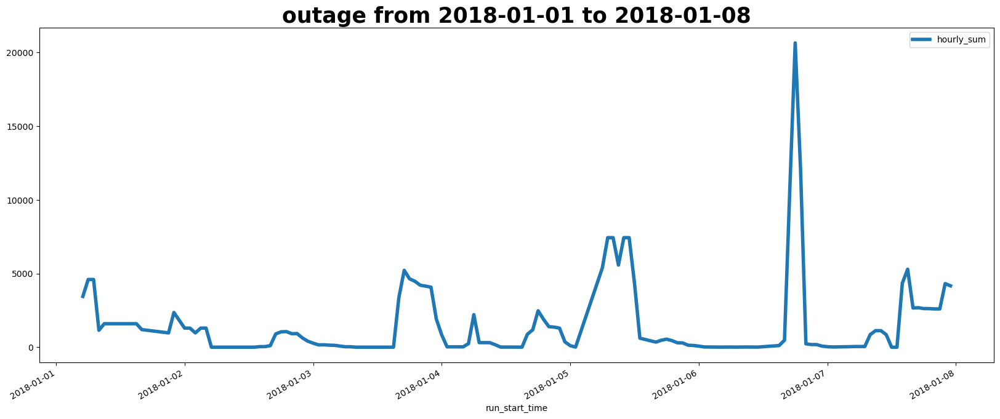

In [148]:
df_2018 = df_final[(df_final.index >= '2018-01-01') & (df_final.index < '2018-01-08')]

df_2018.plot(figsize=(20,8), lw=4)
plt.title('outage from 2018-01-01 to 2018-01-08', weight='bold', fontsize=25)

In [149]:
df = df_final.sort_index()

In [150]:
df

,hourly_sum
run_start_time,
2014-11-01 06:00:00,377.0
2014-11-01 11:00:00,6512.0
2014-11-01 12:00:00,11202.0
2014-11-01 13:00:00,7719.0
2014-11-01 14:00:00,3458.0
...,...
2022-11-12 09:00:00,24.0
2022-11-12 15:00:00,88.0
2022-11-12 16:00:00,100.0


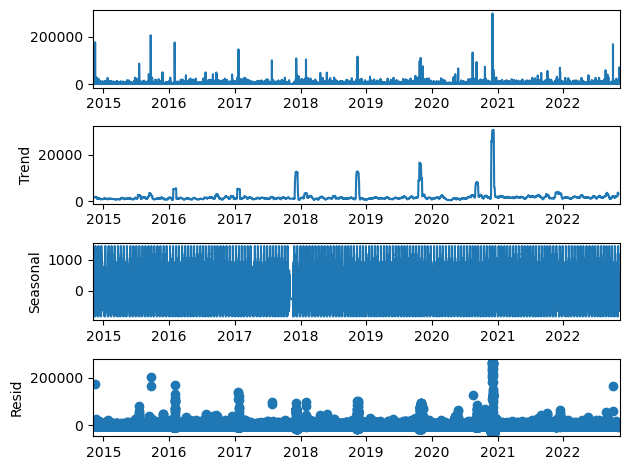

In [151]:
seasonal_decompose(df, period=365).plot()
plt.show()

In [152]:
# Daily Consumption
ma = df.resample('D').mean()

# 3 Day Example
ma['Moving Average'] = ma['hourly_sum'].rolling(3).mean()
ma.head()

,hourly_sum,Moving Average
run_start_time,,
2014-11-01,4695.142857,NaN
2014-11-02,227.958333,NaN
2014-11-03,250.590909,1724.564033
2014-11-04,493.933333,324.160859
2014-11-05,366.625000,370.383081


In [153]:
ma

,hourly_sum,Moving Average
run_start_time,,
2014-11-01,4695.142857,NaN
2014-11-02,227.958333,NaN
2014-11-03,250.590909,1724.564033
2014-11-04,493.933333,324.160859
2014-11-05,366.625000,370.383081
...,...,...
2022-11-08,2798.791667,8816.091270
2022-11-09,898.458333,8639.958333
2022-11-10,402.875000,1366.708333


In [154]:
def moving_average(data, window):
    data['Moving Average'] = data['hourly_sum'].rolling(window).mean()
    actual = data['hourly_sum'][-(window+30):]
    ma = data['Moving Average'][-(window+30):]
    
    plt.figure(figsize=(20,8))
    actual.plot(label='Actual', lw=4)
    ma.plot(label='MA-{}'.format(str(window)), ls='--', lw=2)
    plt.title('{}-Days Moving Average'.format(str(window)), weight='bold', fontsize=25)
    plt.legend()

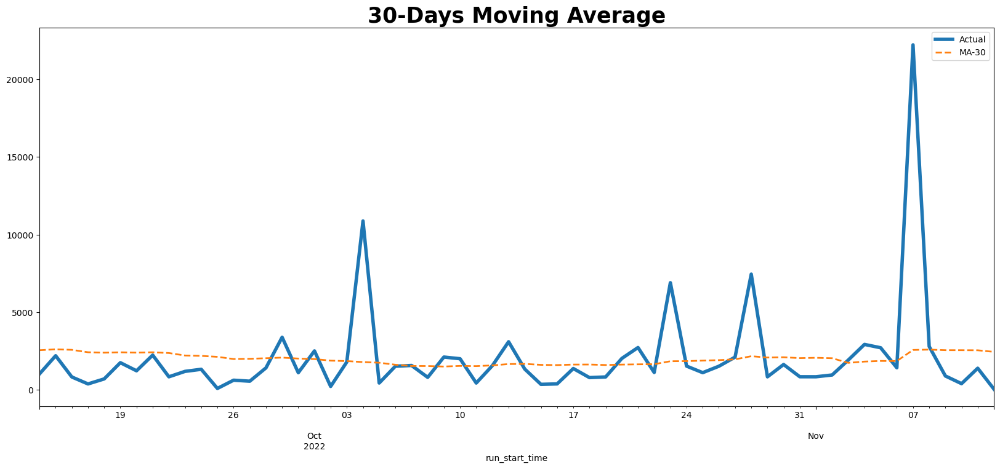

In [155]:
moving_average(ma, 30)

In [156]:
# Before building and training our model, let's split the data into training and testing
df_train, df_test = df[df.index < '2016-01-01'], df[df.index >= '2016-01-01']

print('Train:\t', len(df_train))
print('Test:\t', len(df_test))

Train:	 8984
Test:	 55087


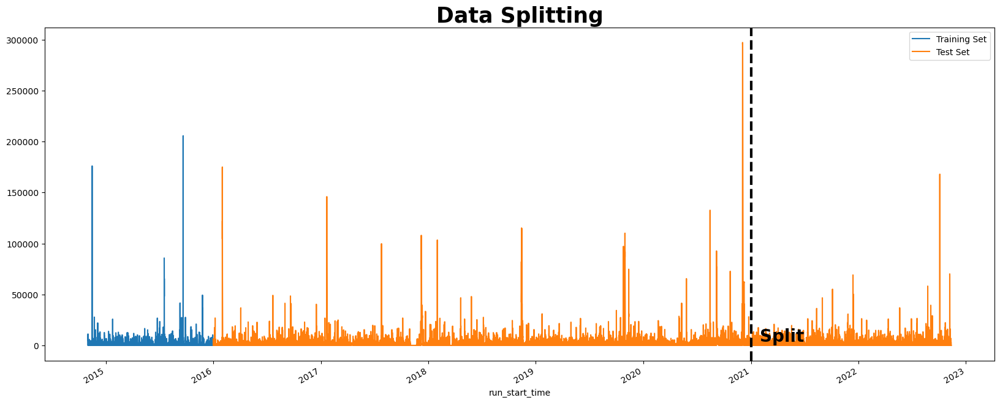

In [158]:
plt.figure(figsize=(20,8))

df_train['hourly_sum'].plot(label='Training Set')
df_test['hourly_sum'].plot(label='Test Set')
plt.axvline('2021-01-01', color='black', ls='--', lw=3)
plt.text('2021-02-01', 3700, 'Split', fontsize=20, fontweight='bold')
plt.title('Data Splitting', weight='bold', fontsize=25)
plt.legend()

In [159]:
def index_to_column(data):
    data = data.reset_index()
    data['run_start_time'] = pd.to_datetime(data['run_start_time'])
    data = data.sort_values('run_start_time')
    data=data.rename(columns={'run_start_time':'ds','hourly_sum': 'y'})
    return data

In [160]:
prophet_train = index_to_column(df_train)
prophet_test = index_to_column(df_test)

In [161]:
prophet_model = Prophet(interval_width=0.95)

prophet_model.fit(prophet_train)
prophet_pred = prophet_model.predict(prophet_test[['ds']]) # Keep the dataset format

15:43:46 - cmdstanpy - INFO - Chain [1] start processing
15:43:47 - cmdstanpy - INFO - Chain [1] done processing


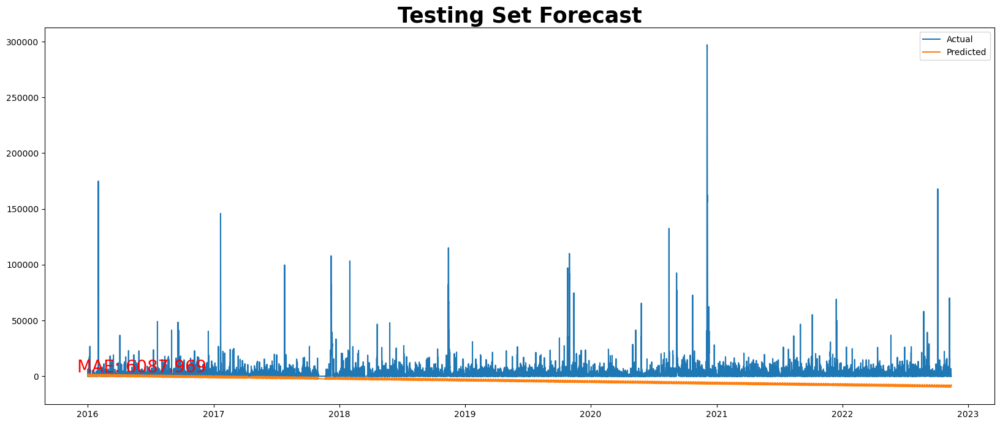

In [162]:
mae = round(mean_absolute_error(prophet_test['y'], prophet_pred['yhat']), 3)

plt.figure(figsize=(20,8))
plt.plot(prophet_test['ds'], prophet_test['y'], label='Actual')
plt.plot(prophet_pred['ds'], prophet_pred['yhat'], label='Predicted')
plt.title('Test Forecasting', weight='bold', fontsize=40)
plt.text(16770, 3250, 'MAE: {}'.format(mae), fontsize=20, color='red')
plt.title('Testing Set Forecast', weight='bold', fontsize=25)
plt.legend()

In [163]:
# This time, we will use all data (train and test) to train our model
new_df = index_to_column(df)

In [164]:
prophet_model2 = Prophet(interval_width=0.95)
prophet_model2.fit(new_df)
# 7 days to the future (7x24 = 168)
future_dates = prophet_model2.make_future_dataframe(periods=168, freq='H')
prophet_pred2 = prophet_model2.predict(future_dates)

15:44:30 - cmdstanpy - INFO - Chain [1] start processing
15:44:50 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 2000x800 with 0 Axes>

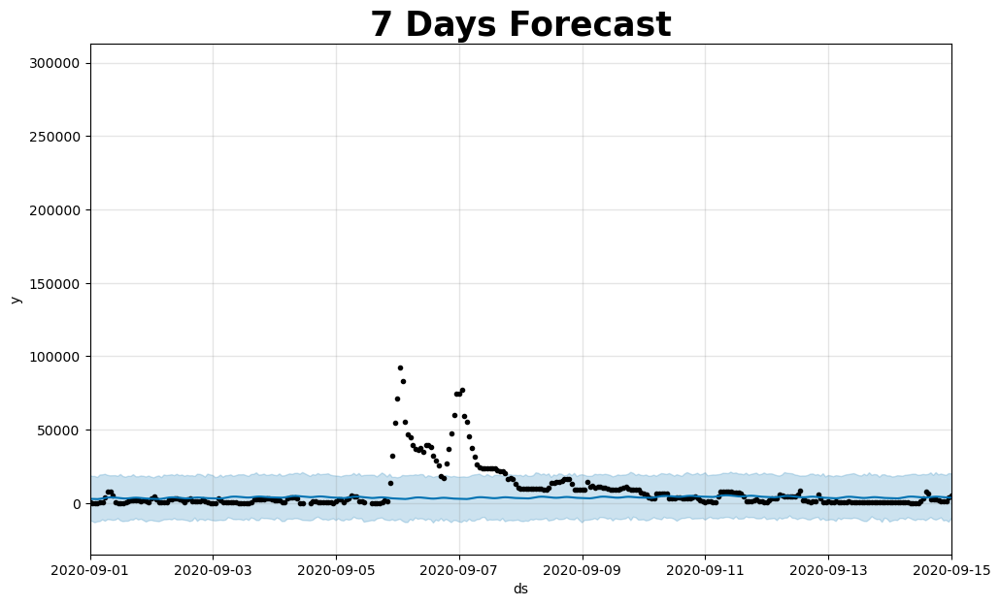

In [170]:
plt.figure(figsize=(20,8))

fig = prophet_model2.plot(prophet_pred2, uncertainty=True)
ax = fig.gca()
ax.set_xlim(pd.to_datetime(['2020-09-01', '2020-09-15']))
plt.title('7 Days Forecast', weight='bold', fontsize=25)
plt.show()

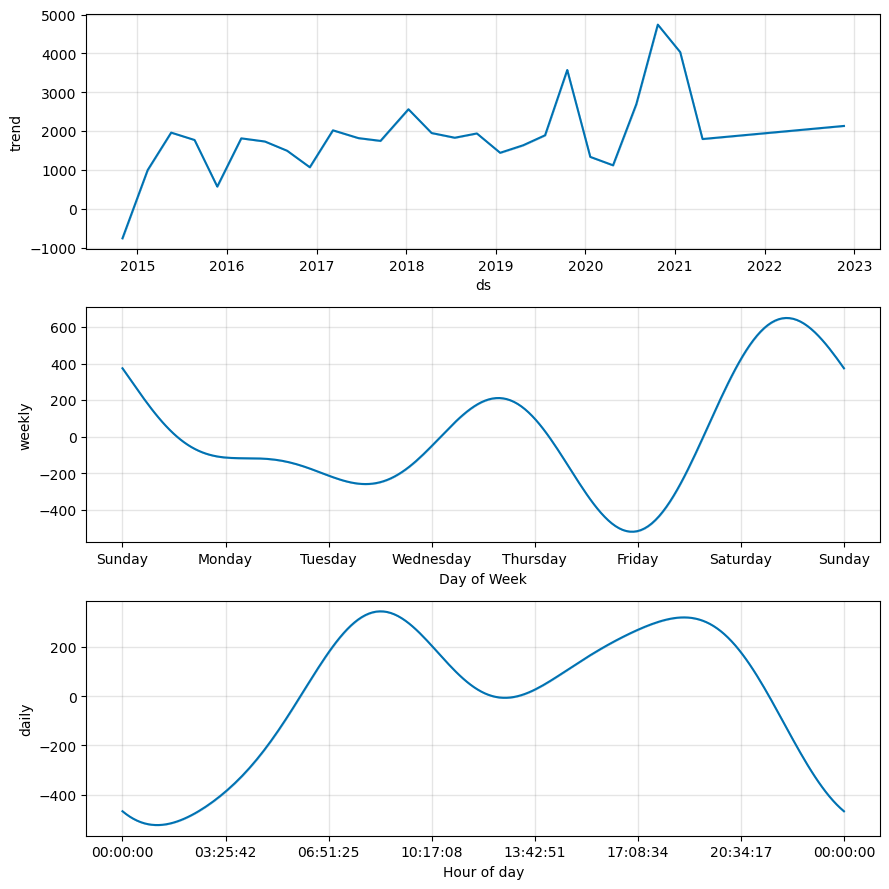

In [171]:
prophet_model.plot_components(prophet_pred2)
plt.show()

<Figure size 2000x800 with 0 Axes>

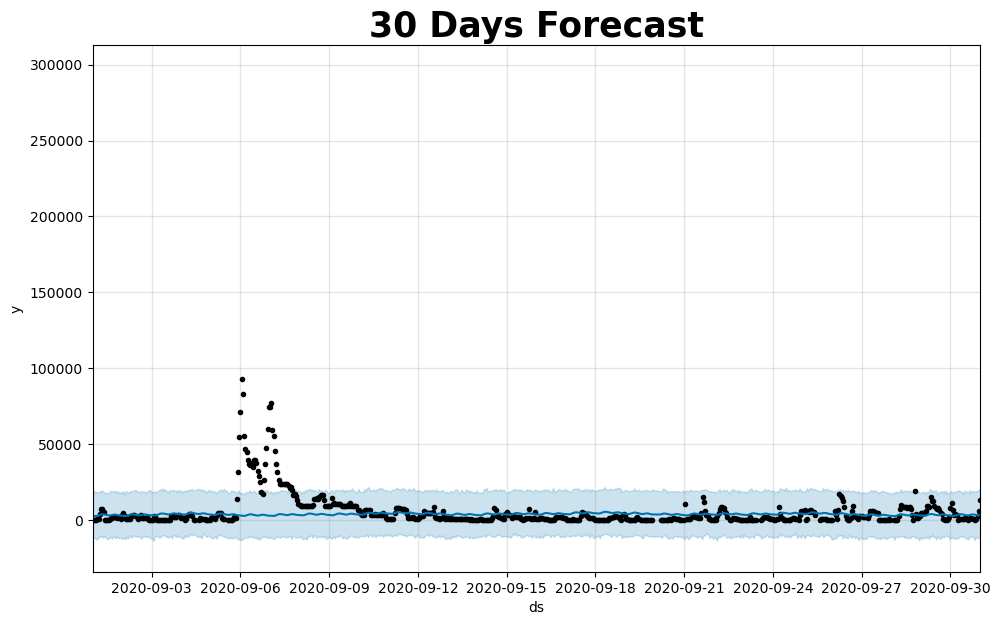

In [173]:
future_dates2 = prophet_model2.make_future_dataframe(periods=720, freq='H')
prophet_pred3 = prophet_model2.predict(future_dates2)

plt.figure(figsize=(20,8))

fig = prophet_model2.plot(prophet_pred3, uncertainty=True)
ax = fig.gca()
ax.set_xlim(pd.to_datetime(['2020-09-01', '2020-10-01']))
plt.title('30 Days Forecast', weight='bold', fontsize=25)
plt.show()

In [174]:
df

,hourly_sum
run_start_time,
2014-11-01 06:00:00,377.0
2014-11-01 11:00:00,6512.0
2014-11-01 12:00:00,11202.0
2014-11-01 13:00:00,7719.0
2014-11-01 14:00:00,3458.0
...,...
2022-11-12 09:00:00,24.0
2022-11-12 15:00:00,88.0
2022-11-12 16:00:00,100.0


In [175]:
df.shape

(64071, 1)

In [176]:
df['date'] = df.index
df['hour'] = df['date'].dt.hour
df['day_of_week'] = df['date'].dt.dayofweek
df['weekday_name'] = df['date'].dt.day_name()
df['quarter'] = df['date'].dt.quarter
df['month'] = df['date'].dt.month
df['year'] = df['date'].dt.year
df['day_of_year'] = df['date'].dt.dayofyear
df['day_of_month'] = df['date'].dt.day
df['week_of_year'] = df['date'].dt.weekofyear

df.head()

C:\Users\halee\AppData\Local\Temp\ipykernel_24392\1400370480.py:10: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  df['week_of_year'] = df['date'].dt.weekofyear


,hourly_sum,date,hour,day_of_week,weekday_name,quarter,month,year,day_of_year,day_of_month,week_of_year
run_start_time,,,,,,,,,,,
2014-11-01 06:00:00,377.0,2014-11-01 06:00:00,6,5,Saturday,4,11,2014,305,1,44
2014-11-01 11:00:00,6512.0,2014-11-01 11:00:00,11,5,Saturday,4,11,2014,305,1,44
2014-11-01 12:00:00,11202.0,2014-11-01 12:00:00,12,5,Saturday,4,11,2014,305,1,44
2014-11-01 13:00:00,7719.0,2014-11-01 13:00:00,13,5,Saturday,4,11,2014,305,1,44
2014-11-01 14:00:00,3458.0,2014-11-01 14:00:00,14,5,Saturday,4,11,2014,305,1,44


In [178]:
import plotly

In [181]:
line_plot(df, 'date', 'hourly_sum', 'American Electric Power Outage- Hourly', 'hourly_sum', 'year')

NameError: name 'line_plot' is not defined

In [180]:
import pandas as pd
import math
import numpy as np

# ---------------------------------------
import matplotlib.pyplot as plt
import seaborn as sns
import pylab 
plt.rcParams['figure.figsize']=(17,5)

# ---------------------------------------
import plotly.express as px
import plotly.graph_objs as go
from plotly.offline import iplot

In [182]:
line_plot(df, 'date', 'hourly_sum', 'American Electric Power Outage- Hourly', 'hourly_sum', 'year')

NameError: name 'line_plot' is not defined

In [183]:
import holidays
from sklearn.metrics import mean_squared_error, mean_absolute_error

import warnings
warnings.filterwarnings("ignore")

In [192]:
def line_plot(df, date, AEP, text, y_tiltle, x_title):
    data = go.Scatter(x = df[date],
                      y = df[AEP],
                      mode = 'lines',
                      name = AEP)

    layout = go.Layout(title={'text': text,
                              'y':0.9,
                              'x':0.5,
                              'xanchor': 'center',
                              'yanchor': 'top'},
                       xaxis = dict(title = x_title),
                       yaxis = dict(title = y_tiltle),
                       template = 'plotly_dark')

    fig = go.Figure(data = data, layout = layout)
    iplot(fig)
    
# ---------------------------------------
def new_df(df, col, new_date, new_AEP, split):
    tmp_df = df[[col]].reset_index().rename(columns={'run_start_time':new_date, 'hourly_sum':new_AEP})
    tmp_df = pd.DataFrame(tmp_df.resample(split, on='run_start_time', origin = 'start').mean())
    tmp_df.reset_index(inplace=True)
    return tmp_df

# ---------------------------------------
def bar_plot(col1, col2, agg_func, title, xtitle, ytitle):
    data = go.Bar(x = df.groupby(col1).agg({col2: agg_func}). \
              reset_index()[col1],
              y = df.groupby(col1).agg({col2: agg_func}). \
              reset_index()[col2],
              text =round(df.groupby(col1).agg({col2: agg_func}).reset_index()[col2],2),
              textposition= 'outside')

    layout = go.Layout(title={'text': title,
                              'y':0.9,
                              'x':0.5,
                              'xanchor': 'center',
                              'yanchor': 'top'},
                       xaxis = dict(title = xtitle),
                       yaxis = dict(title = ytitle),
                       template = 'plotly_dark')

    fig = go.Figure(data = data, layout = layout)
    iplot(fig)


# ---------------------------------------
def box_plot(q_num, col1, col2, color, title, xtitle, ytitle):
    box = go.Box(x = df.loc[df['quarter']==q_num][col1],
                       y = df.loc[df['quarter']==q_num][col2],
                       name = col1, 
                       marker_color= color)

    layout = go.Layout(title={'text': title,
                              'y':0.9,
                              'x':0.5,
                              'xanchor': 'center',
                              'yanchor': 'top'},
                       xaxis = dict(title = xtitle),
                       yaxis = dict(title = ytitle),
                       template = 'plotly_dark')


    fig = go.Figure(data = box, layout = layout)
    iplot(fig)


# ---------------------------------------
def MAPE(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [196]:
line_plot(df, 'date', 'hourly_sum', 'American Electric Power Outage- Hourly for san Diego', 'hourly_sum', 'year')

In [197]:
df_monthly = new_df(df, 'hourly_sum', 'run_start_time', 'monthly', 'M')
df_monthly.head()

,run_start_time,monthly
0,2014-11-30,1429.596154
1,2014-12-31,1033.884808
2,2015-01-31,1005.936791
3,2015-02-28,1148.162116
4,2015-03-31,791.698057


In [198]:
line_plot(df_monthly, 'run_start_time', 'monthly', 'American Electric Power outage for San Diego- Monthly', 'monthly', 'year')

In [199]:
fig = px.line(df, x='date', y='hourly_sum', 
              title='American Electric Power outage with Range Slider and Selectors', 
             )

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [201]:
scatter = [go.Scatter(x = df['hour'],
                      y = df['hourly_sum'],
                      mode ='markers',
                      marker = dict(color = df['hourly_sum'],
                                    showscale = True,
                                   colorscale = 'OrRd',
                                   colorbar = dict(title='hourly_sum'),
                                    size = 9,
                                    opacity = 0.55))]

layout = go.Layout(title={'text': "American Electric Power outage of SanDiego by hour of day",
                          'y':0.9,
                          'x':0.5,
                          'xanchor': 'center',
                          'yanchor': 'top'},
                   xaxis = dict(title = 'Day'),
                   yaxis = dict(title = 'hourly_sum'),
                   template = 'plotly_dark')

fig = go.Figure(data = scatter, layout = layout)
iplot(fig)

In [202]:
bar_plot('year', 'hourly_sum', 'sum', 'Total American electric power outage per year', 
         'year', 'hourly_sum')

In [205]:
bar_plot('month', 'hourly_sum', 'sum', 'Total American electric power outage of san Diego per month', 
         'month', 'hourly_sum')

In [206]:
df_pivot = df.pivot_table(index=df['hour'], columns='weekday_name', values='hourly_sum',
               aggfunc='sum')
df_pivot = df_pivot[['Friday', 'Monday', 'Saturday', 'Sunday', 'Thursday', 'Tuesday',
       'Wednesday']].reset_index().rename(columns={'hour':'hour'})

In [207]:
Monday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Monday'],
                  mode = 'lines',
                  name = 'Monday')

Tuesday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Tuesday'],
                  mode = 'lines',
                  name = 'Tuesday')

Wednesday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Wednesday'],
                  mode = 'lines',
                  name = 'Wednesday')

Thursday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Thursday'],
                  mode = 'lines',
                  name = 'Thursday')

Friday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Friday'],
                  mode = 'lines',
                  name = 'Friday')

Saturday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Saturday'],
                  mode = 'lines',
                  name = 'Saturday')

Sunday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Sunday'],
                  mode = 'lines',
                  name = 'Sunday')

layout = go.Layout(title={'text': 'American electric power outage of San diego - hourly trends',
                          'y':0.9,
                          'x':0.5,
                          'xanchor': 'center',
                          'yanchor': 'top'},
                   xaxis = dict(title = 'Hour'),
                   yaxis = dict(title = 'hourly_sum'),
                   template = 'plotly_dark')

data = [Monday, Tuesday, Wednesday, Thursday, Friday, Saturday, Sunday]
fig = go.Figure(data = data, layout = layout)
iplot(fig)

In [209]:
box_plot(1, 'hour', 'hourly_sum', '#65e3fc', 'American electric power outage in San Diego per year in Q1', 
            'Hour', 'hourly_sum')

In [210]:
box_plot(2, 'hour', 'hourly_sum', '#65fc67', 'American electric power outage in San diego per year in Q2', 
            'Hour', 'hourly_sum')

In [211]:
box_plot(3, 'hour', 'hourly_sum', '#fc3e32', 'American electric power outage per year in Q3', 
            'Hour', 'hourly_sum')

In [212]:
box_plot(4, 'hour', 'hourly_sum', 'orange', 'American electric power outage per year in Q4', 
            'Hour', 'hourly_sum')

# modelling with prophet

In [221]:
df_new = df[['hourly_sum']].reset_index().rename(columns={'run_start_time':'ds', 'hourly_sum':'y'})
df_new.head()

,ds,y
0,2014-11-01 06:00:00,377.0
1,2014-11-01 11:00:00,6512.0
2,2014-11-01 12:00:00,11202.0
3,2014-11-01 13:00:00,7719.0
4,2014-11-01 14:00:00,3458.0


In [222]:
train_len = math.floor((df_new.shape[0]*90)/100)
train_len

57663

In [223]:
train = df_new[:train_len]
test = df_new[train_len:]

In [224]:
train.tail()

,ds,y
57658,2022-02-02 06:00:00,207.0
57659,2022-02-02 07:00:00,212.0
57660,2022-02-02 08:00:00,212.0
57661,2022-02-02 09:00:00,29.0
57662,2022-02-02 10:00:00,20.0


In [225]:
test.head()

,ds,y
57663,2022-02-02 11:00:00,20.0
57664,2022-02-02 12:00:00,20.0
57665,2022-02-02 13:00:00,20.0
57666,2022-02-02 14:00:00,22.0
57667,2022-02-02 15:00:00,24.0


In [227]:
train_samples = go.Scatter(x = train['ds'],
                  y = train['y'],
                  mode = 'lines',
                  name = 'Train')

test_samples = go.Scatter(x = test['ds'],
                  y = test['y'],
                  mode = 'lines',
                  name = 'Test')

layout = go.Layout(title={'text': 'Train/test split',
                          'y':0.9,
                          'x':0.5,
                          'xanchor': 'center',
                          'yanchor': 'top'},
                   xaxis = dict(title = 'Year'),
                   yaxis = dict(title = 'hourly_sum'),
                   template = 'plotly_dark')

data = [train_samples, test_samples]
fig = go.Figure(data = data, layout = layout)
iplot(fig)

In [228]:
prophet_model = Prophet()
prophet_model.fit(train)

16:20:47 - cmdstanpy - INFO - Chain [1] start processing
16:21:02 - cmdstanpy - INFO - Chain [1] done processing


In [229]:
test_forecast = prophet_model.predict(test)
test_forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head()

,ds,yhat,yhat_lower,yhat_upper
0,2022-02-02 11:00:00,1040.796287,-9454.549529,10440.548230
1,2022-02-02 12:00:00,858.508052,-9453.521643,12031.167522
2,2022-02-02 13:00:00,720.597947,-9410.458099,10383.639182
3,2022-02-02 14:00:00,684.331906,-9708.426274,11706.685473
4,2022-02-02 15:00:00,779.612370,-9714.598929,11643.405000


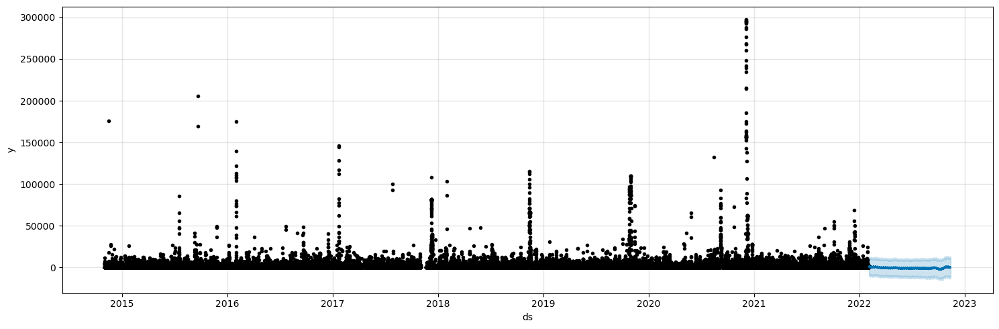

In [230]:
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(15)
fig = prophet_model.plot(test_forecast,ax=ax)
plt.show()

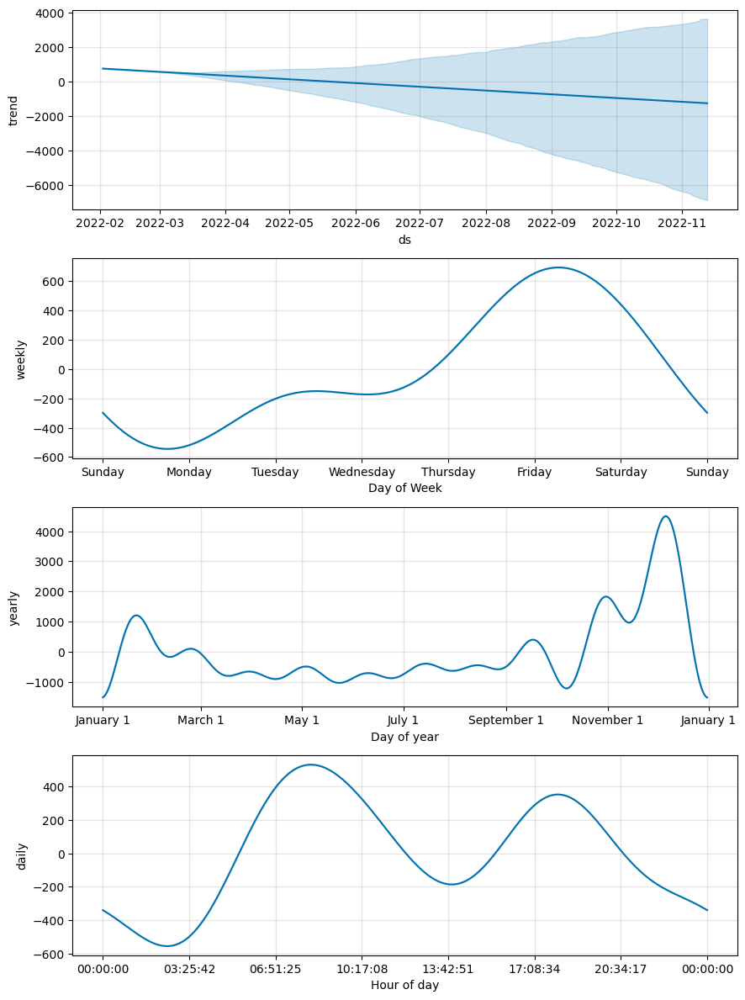

In [231]:
prophet_model.plot_components(test_forecast)
plt.show()

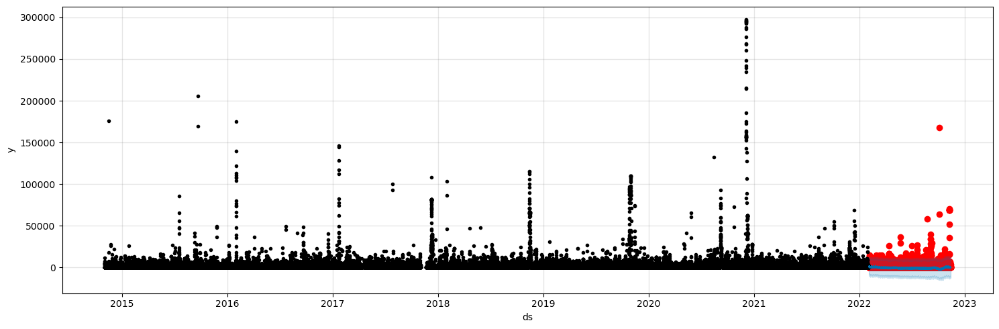

In [232]:
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(15)
ax.scatter(test.ds, test['y'], color='r')
fig = prophet_model.plot(test_forecast, ax=ax)

In [233]:
future = prophet_model.make_future_dataframe(periods=500, freq='D')
forecast_future = prophet_model.predict(future)
forecast_future[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head()

,ds,yhat,yhat_lower,yhat_upper
0,2014-11-01 06:00:00,1118.646822,-9162.492398,10879.051372
1,2014-11-01 11:00:00,967.726395,-9108.417640,11114.025219
2,2014-11-01 12:00:00,746.066320,-10134.709641,11172.026924
3,2014-11-01 13:00:00,567.497164,-10394.636538,10059.470748
4,2014-11-01 14:00:00,489.370699,-9778.462974,10521.481021


In [234]:
forecast_future[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
58158,2023-06-13 10:00:00,-3283.430035,-22070.402979,12396.705741
58159,2023-06-14 10:00:00,-3294.153090,-20705.745749,14037.005037
58160,2023-06-15 10:00:00,-2814.180746,-20515.907614,13769.029734
58161,2023-06-16 10:00:00,-2519.406488,-20073.852931,13754.911070
58162,2023-06-17 10:00:00,-3093.572353,-21611.876730,13697.486588


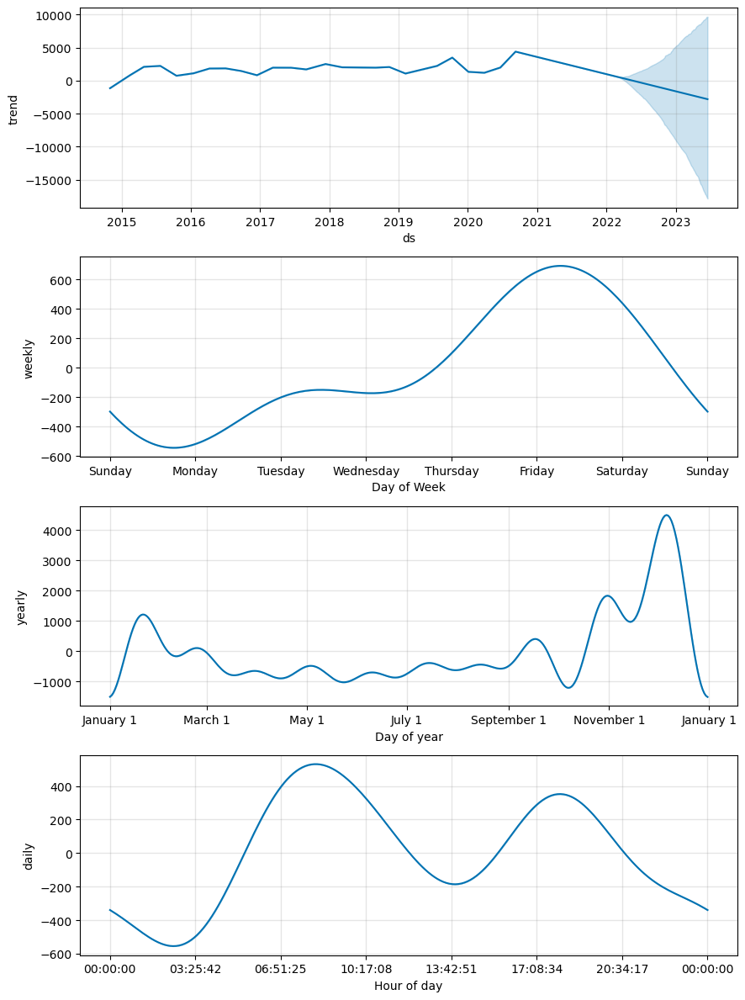

In [235]:
prophet_model.plot_components(forecast_future)
plt.show()

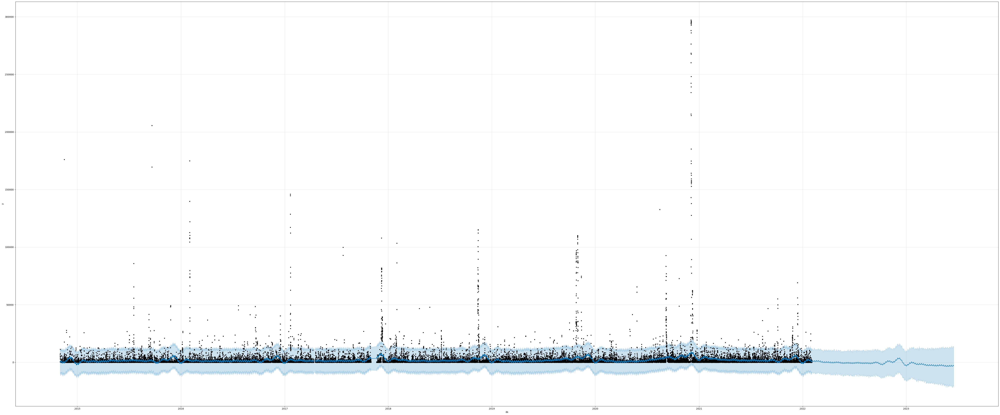

In [239]:
f, ax = plt.subplots(1)
f.set_figheight(25)
f.set_figwidth(60)
fig = prophet_model.plot(forecast_future,ax=ax)
plt.show()

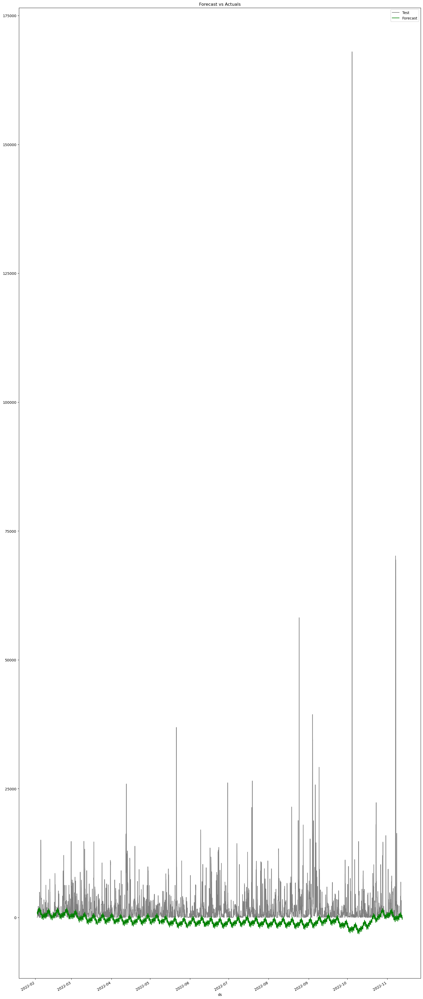

In [254]:
f, ax = plt.subplots(figsize=(14,5))
f.set_figheight(55)
f.set_figwidth(20)
test.plot(kind='line',x='ds', y='y', color='gray', label='Test', ax=ax)
test_forecast.plot(kind='line',x='ds',y='yhat', color='green',label='Forecast', ax=ax)
plt.title('Forecast vs Actuals')
plt.show()

In [246]:
mape = MAPE(test['y'],test_forecast['yhat'])
print("MAPE",round(mape,4))

MAPE inf


In [247]:
holiday = pd.DataFrame([])
for date, name in sorted(holidays.UnitedStates(years=[2014, 
                                                      2015, 2016, 2017, 2018,2019,2020,2021,2022]).items()):
    holiday = holiday.append(pd.DataFrame({'ds': date, 'holiday': "US-Holidays"}, index=[0]), ignore_index=True)
holiday['ds'] = pd.to_datetime(holiday['ds'], format='%Y-%m-%d', errors='ignore')

In [248]:
holiday.head()

,ds,holiday
0,2014-01-01,US-Holidays
1,2014-01-20,US-Holidays
2,2014-02-17,US-Holidays
3,2014-05-26,US-Holidays
4,2014-07-04,US-Holidays


In [249]:
prophet_model_with_holidays = Prophet(holidays=holiday)
prophet_model_with_holidays.fit(train)

16:29:17 - cmdstanpy - INFO - Chain [1] start processing
16:29:38 - cmdstanpy - INFO - Chain [1] done processing


In [250]:
future = prophet_model_with_holidays.make_future_dataframe(periods=500, freq='D')
forecast = prophet_model_with_holidays.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
58158,2023-06-13 10:00:00,-3325.360071,-22833.451900,15371.239999
58159,2023-06-14 10:00:00,-3335.227980,-23292.654278,15232.498030
58160,2023-06-15 10:00:00,-2855.878833,-20721.749782,15250.253865
58161,2023-06-16 10:00:00,-2559.495519,-20995.099604,16196.268697
58162,2023-06-17 10:00:00,-3134.372495,-21339.405930,15360.490433


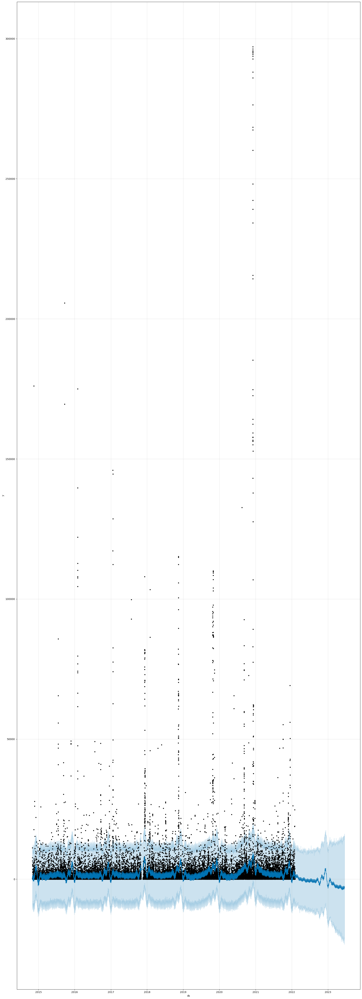

In [253]:
f, ax = plt.subplots(1)
f.set_figheight(55)
f.set_figwidth(20)
fig = prophet_model_with_holidays.plot(forecast,ax=ax)
plt.show()

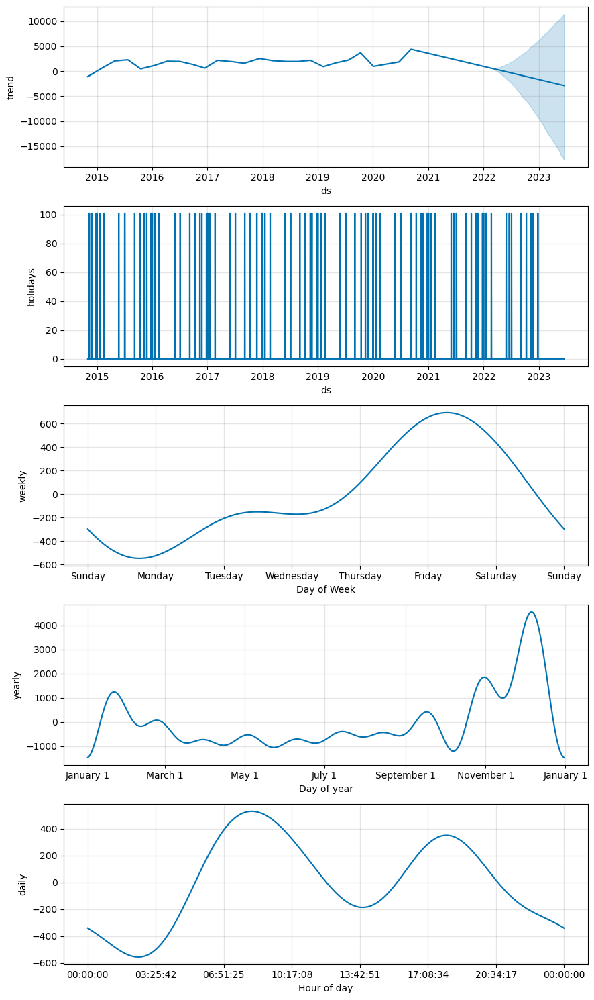

In [255]:
fig = prophet_model_with_holidays.plot_components(forecast)

In [256]:
test_forecast_holiday = prophet_model_with_holidays.predict(test)
test_forecast_holiday[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
6403,2022-11-12 09:00:00,393.515514,-12091.976931,11928.537991
6404,2022-11-12 15:00:00,-411.324316,-12994.520653,13557.902212
6405,2022-11-12 16:00:00,-262.668671,-12235.278478,12136.653135
6406,2022-11-12 17:00:00,-111.393904,-12647.375566,12387.630087
6407,2022-11-12 18:00:00,-61.069654,-12598.003988,12724.067138


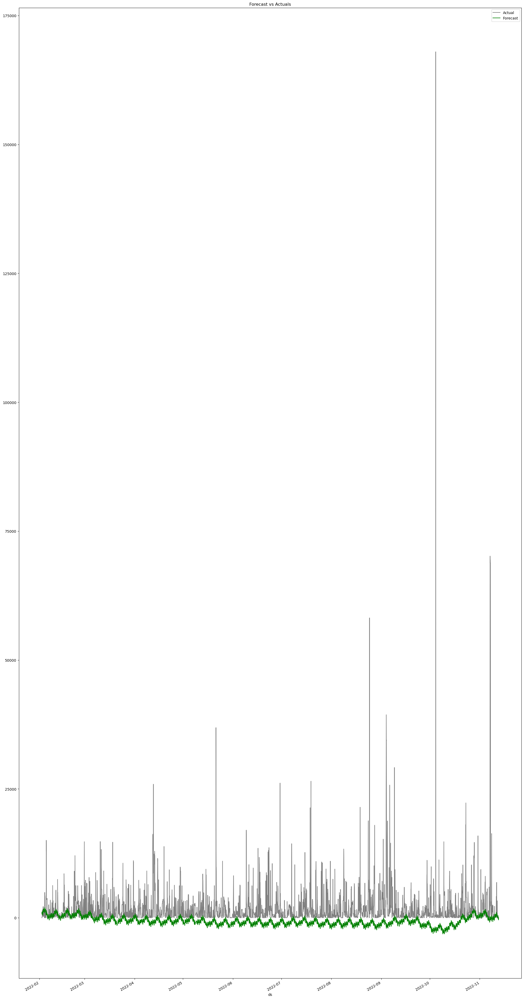

In [260]:
f, ax = plt.subplots(figsize=(14,5))
f.set_figheight(55)
f.set_figwidth(25)
test.plot(kind='line',x='ds', y='y', color='gray', label='Actual', ax=ax)
test_forecast_holiday.plot(kind='line',x='ds',y='yhat', color='green',label='Forecast', ax=ax)
plt.title('Forecast vs Actuals')
plt.show()

In [261]:
mape = MAPE(test['y'],test_forecast_holiday['yhat'])
print("MAPE",round(mape,4))

MAPE inf


In [262]:
df

,hourly_sum,date,hour,day_of_week,weekday_name,quarter,month,year,day_of_year,day_of_month,week_of_year
run_start_time,,,,,,,,,,,
2014-11-01 06:00:00,377.0,2014-11-01 06:00:00,6,5,Saturday,4,11,2014,305,1,44
2014-11-01 11:00:00,6512.0,2014-11-01 11:00:00,11,5,Saturday,4,11,2014,305,1,44
2014-11-01 12:00:00,11202.0,2014-11-01 12:00:00,12,5,Saturday,4,11,2014,305,1,44
2014-11-01 13:00:00,7719.0,2014-11-01 13:00:00,13,5,Saturday,4,11,2014,305,1,44
2014-11-01 14:00:00,3458.0,2014-11-01 14:00:00,14,5,Saturday,4,11,2014,305,1,44
...,...,...,...,...,...,...,...,...,...,...,...
2022-11-12 09:00:00,24.0,2022-11-12 09:00:00,9,5,Saturday,4,11,2022,316,12,45
2022-11-12 15:00:00,88.0,2022-11-12 15:00:00,15,5,Saturday,4,11,2022,316,12,45
2022-11-12 16:00:00,100.0,2022-11-12 16:00:00,16,5,Saturday,4,11,2022,316,12,45


In [263]:
df_final

,hourly_sum
run_start_time,
2014-11-01 06:00:00,377.0
2014-11-01 11:00:00,6512.0
2014-11-01 12:00:00,11202.0
2014-11-01 13:00:00,7719.0
2014-11-01 14:00:00,3458.0
...,...
2022-11-12 09:00:00,24.0
2022-11-12 15:00:00,88.0
2022-11-12 16:00:00,100.0


In [264]:
import warnings
warnings.filterwarnings("ignore")

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime 

# xgboost

In [267]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns
import matplotlib.pyplot as plt
import xgboost as xg


from sklearn.metrics import mean_squared_error

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

In [266]:
df_final

,hourly_sum
run_start_time,
2014-11-01 06:00:00,377.0
2014-11-01 11:00:00,6512.0
2014-11-01 12:00:00,11202.0
2014-11-01 13:00:00,7719.0
2014-11-01 14:00:00,3458.0
...,...
2022-11-12 09:00:00,24.0
2022-11-12 15:00:00,88.0
2022-11-12 16:00:00,100.0


In [269]:
df1=df_final

<Axes: title={'center': ' Hourly Power outage in san diego'}, xlabel='run_start_time'>

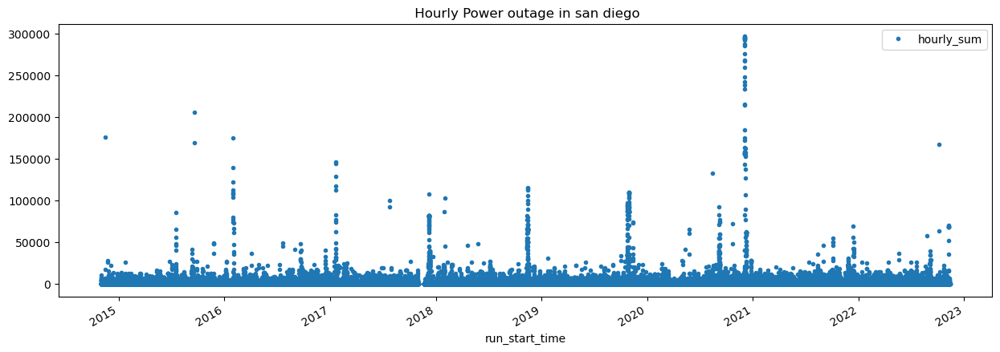

In [270]:
df1.plot(style=".", figsize=(15,5), title=" Hourly Power outage in san diego")

In [271]:
train = df.loc[df.index < '06-01-2021']
test = df.loc[df.index >= '06-01-2021']

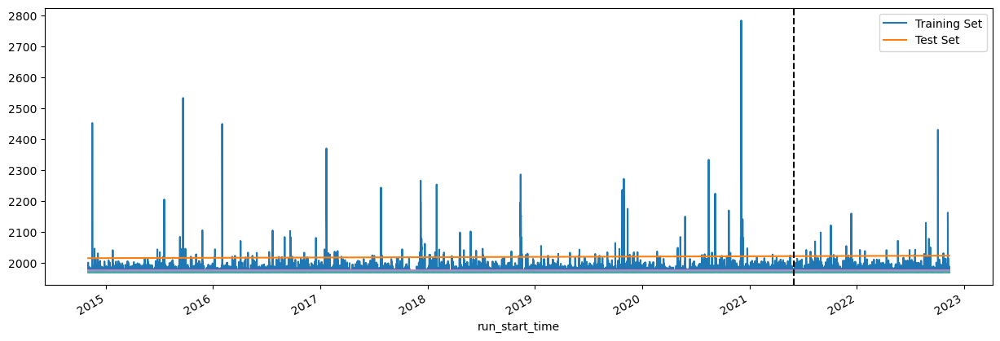

In [272]:
fig, ax = plt.subplots(figsize=(15,5))
train.plot(ax=ax, label="Train")
test.plot(ax=ax, label="Test")

ax.axvline('06-01-2021',color="black",ls="--")
ax.legend(['Training Set','Test Set'])
plt.show()

<Axes: xlabel='run_start_time'>

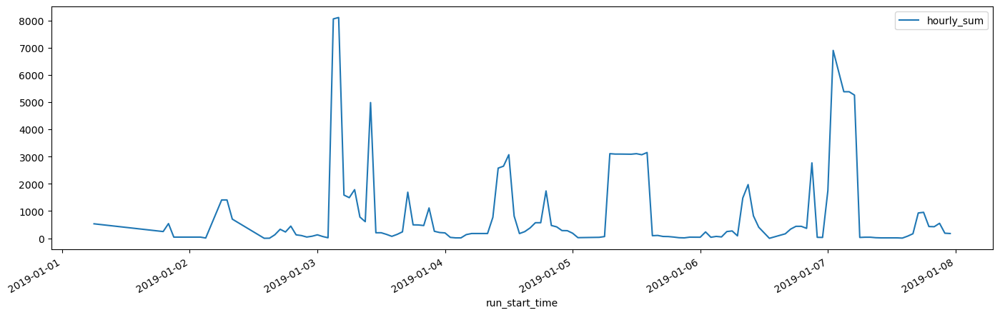

In [273]:
df1.loc[(df1.index > '01-01-2019') & (df1.index < '01-08-2019')].plot()

In [274]:
def create_time_series_features(dataframe):
    df1 = dataframe.copy()
    df1['hour'] = df1.index.hour
    df1['dayofweek'] = df1.index.dayofweek
    df1['quarter'] = df1.index.quarter
    df1['month'] = df1.index.month
    df1['year'] = df1.index.year
    df1['dayofyear'] = df1.index.dayofyear
    
    return df1

In [275]:
df1 = create_time_series_features(df1)

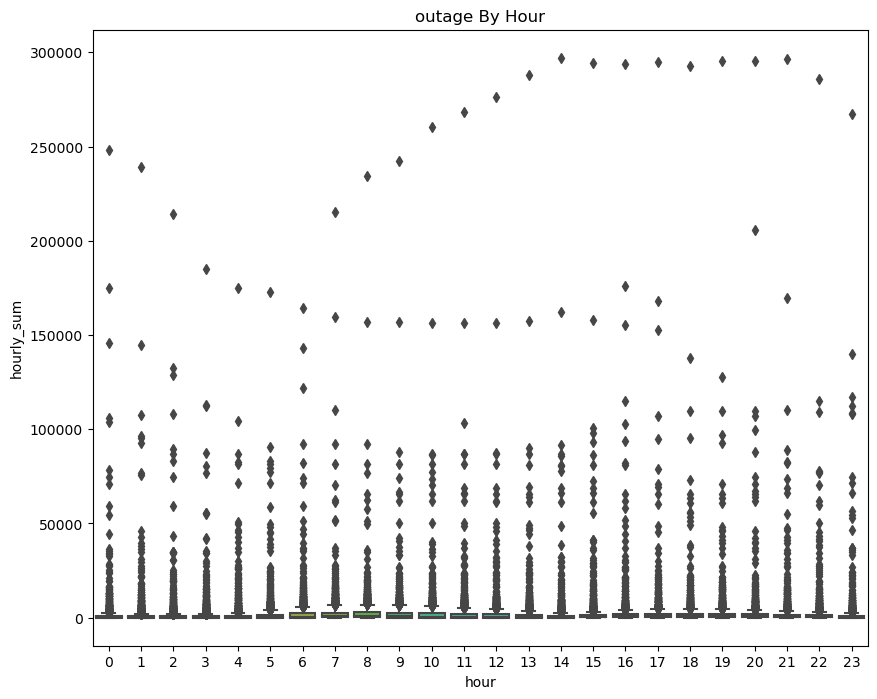

In [276]:
fig, ax = plt.subplots(figsize=(10,8))
sns.boxplot(data=df1, x="hour",y="hourly_sum")
ax.set_title("outage By Hour")
plt.show()

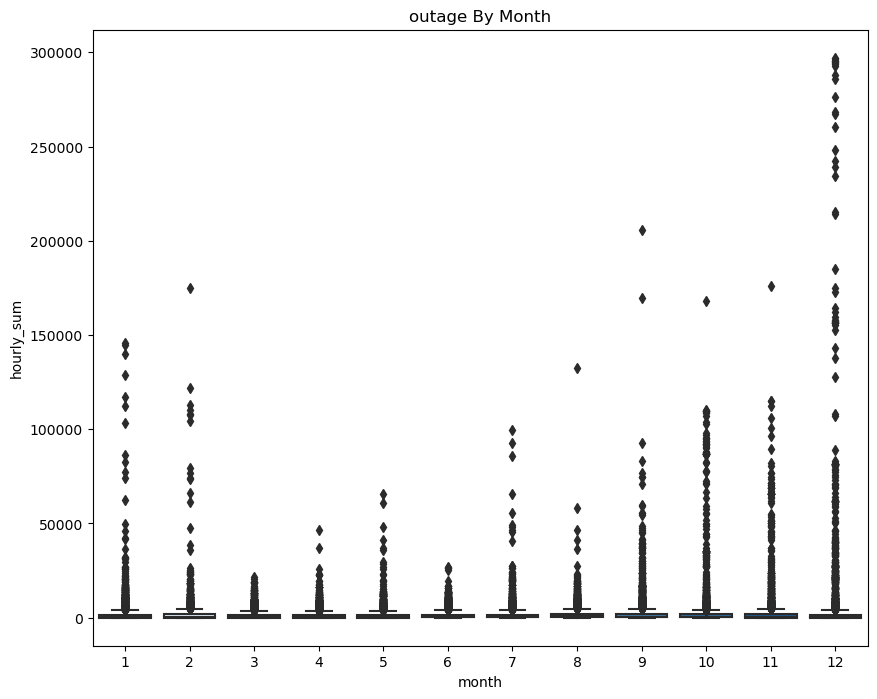

In [277]:
fig, ax = plt.subplots(figsize=(10,8))
sns.boxplot(data=df1, x="month",y="hourly_sum",palette="Blues")
ax.set_title("outage By Month")
plt.show()

In [278]:
df1.columns

Index(['hourly_sum', 'hour', 'dayofweek', 'quarter', 'month', 'year',
       'dayofyear'],
      dtype='object')

In [279]:
FEATURES = ['hour', 'dayofweek', 'quarter', 'month', 'year',
       'dayofyear']

OUTPUT = ['hourly_sum']

In [280]:
train = create_time_series_features(train)
test = create_time_series_features(test)

In [281]:
X_train = train[FEATURES]
y_train = train[OUTPUT]

X_test = test[FEATURES]
y_test = test[OUTPUT]

In [282]:
reg = xg.XGBRegressor(n_estimators=1000,early_stopping_rounds=50, learning_rate=0.01)
reg.fit(
    X_train, 
    y_train, 
    eval_set=[(X_train, y_train),(X_test, y_test)],
    verbose=100
)

[0]	validation_0-rmse:8682.80653	validation_1-rmse:4523.18661
[52]	validation_0-rmse:6998.10901	validation_1-rmse:6010.65861


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=50,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.01, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=1000, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [283]:
f1 = pd.DataFrame(data=reg.feature_importances_, index=reg.feature_names_in_, columns=['importance'])

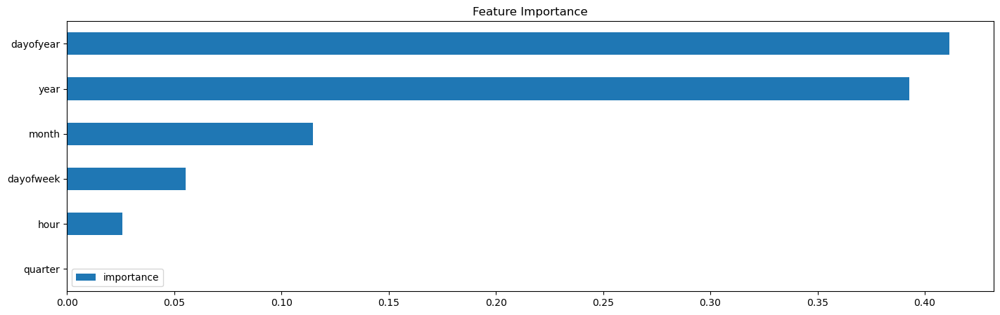

In [284]:
f1.sort_values('importance').plot(kind="barh",title="Feature Importance")
plt.show()

In [285]:
test['predictions'] = reg.predict(X_test)

In [286]:
df1 = df1.merge(test[['predictions']], how='left',left_index=True, right_index=True)

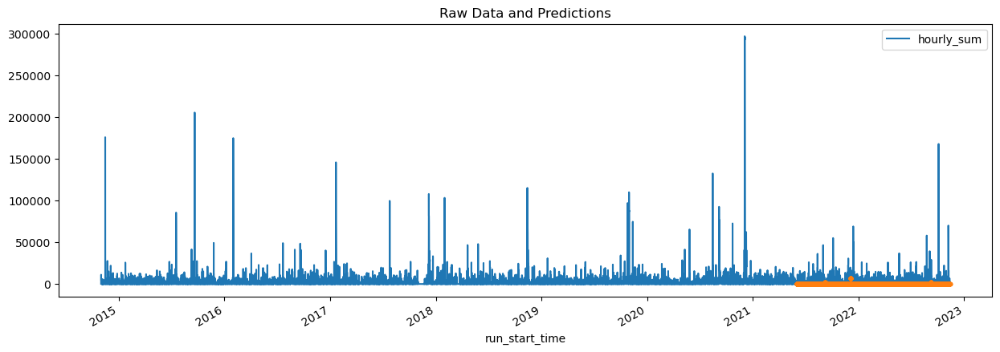

In [291]:
ax = df1[['hourly_sum']].plot(figsize=(15,5))
df1['predictions'].plot(ax=ax, style=".")
ax.set_title("Raw Data and Predictions")
plt.show()

In [292]:
score = np.sqrt(mean_squared_error(test['hourly_sum'],test['predictions']))
print(f'RMSE SCORE: {score}')

RMSE SCORE: 4512.814123728272


<Axes: ylabel='Frequency'>

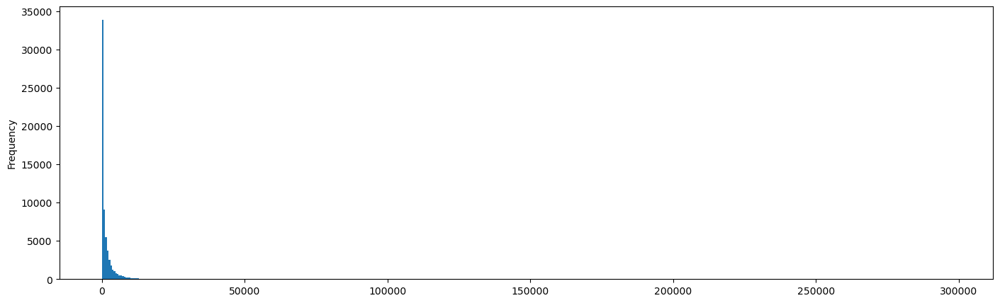

In [293]:
df['hourly_sum'].plot(kind="hist",bins=500)

In [307]:
df1 = df1.query('hourly_sum > 100').copy()

In [308]:
from sklearn.model_selection import TimeSeriesSplit

In [309]:
tss = TimeSeriesSplit(n_splits=5, test_size=24*365*1,gap=24)
df1 = df1.sort_index()

IndexError: positional indexers are out-of-bounds

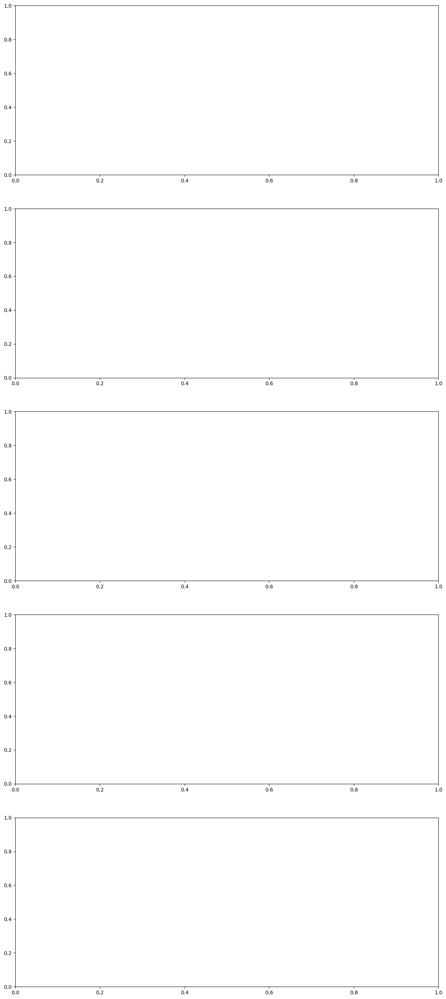

In [311]:
fig, axs = plt.subplots(5,1,figsize=(15,35))


fold = 0
for train_idx, val_idx in tss.split(df):
    
    train = df1.iloc[train_idx]
    test = df1.iloc[val_idx]
    
    train['hourly_sum'].plot(
        ax=axs[fold],
        label="Training Set",
        title=f"Data Train/Test Split Fold {fold}"
    )
    
    
    test['hourly_sum'].plot(
        ax=axs[fold],
        label="Test Set",
    )
    
    fold += 1


In [312]:
df1 = create_time_series_features(df1)


In [313]:
target_map = df1['hourly_sum'].to_dict()

In [314]:
def add_lags(dframe):
    df1 = dframe.copy()
    df1['lag1'] = (df1.index - pd.Timedelta('364 days')).map(target_map)
    df1['lag2'] = (df1.index - pd.Timedelta('728 days')).map(target_map)
    df1['lag3'] = (df1.index - pd.Timedelta('1092 days')).map(target_map)
    
    return df1

In [315]:
df1 = add_lags(df1)

In [316]:
 df1.tail()

,hourly_sum,hour,dayofweek,quarter,month,year,dayofyear,predictions,lag1,lag2,lag3
run_start_time,,,,,,,,,,,
2022-11-07 12:00:00,68812.0,12,0,4,11,2022,311,202.006897,NaN,NaN,NaN
2022-11-07 13:00:00,69389.0,13,0,4,11,2022,311,202.006897,NaN,NaN,NaN
2022-11-07 14:00:00,68812.0,14,0,4,11,2022,311,202.006897,NaN,NaN,NaN
2022-11-07 15:00:00,68824.0,15,0,4,11,2022,311,202.006897,NaN,NaN,NaN
2022-11-07 16:00:00,52058.0,16,0,4,11,2022,311,202.006897,NaN,NaN,NaN


In [317]:
tss = TimeSeriesSplit(n_splits=5, test_size=24*365*1,gap=24)
df1 = df1.sort_index()

In [318]:
df1.columns

Index(['hourly_sum', 'hour', 'dayofweek', 'quarter', 'month', 'year',
       'dayofyear', 'predictions', 'lag1', 'lag2', 'lag3'],
      dtype='object')

In [319]:
fold = 0
preds = []
scores = []

for train_idx, val_idx in tss.split(df):
    train = df.iloc[train_idx]
    test = df.iloc[val_idx]
    
    train = create_time_series_features(train)
    test = create_time_series_features(test)
    
    FEATURES = ['hour', 'dayofweek', 'quarter', 'month', 'year', 'dayofyear',
       'lag1', 'lag2', 'lag3']

    OUTPUT = 'hourly_sum'
    
    X_train = train[FEATURES]
    y_train = train[OUTPUT]
    
    X_test = test[FEATURES]
    y_test = test[OUTPUT]
    
    reg = xg.XGBRegressor(
        base_score=0.5,
        booster='gbtree',
        n_estimators=1000,
        early_stopping_rounds=50,
        objective='reg:linear',
        max_depth=3,
        learning_rate=0.01
    )
    
    reg.fit(
        X_train, 
        y_train,
        eval_set=[(X_train, y_train),(X_test, y_test)],
        verbose=100
    )
    
    y_pred = reg.predict(X_test)
    preds.append(y_pred)
    score = np.sqrt(mean_squared_error(y_test, y_pred))
    scores.append(score)

KeyError: "['lag1', 'lag2', 'lag3'] not in index"

In [320]:
# Sort the DataFrame by the "run_start_time" column in ascending order
df1.sort_values(by='run_start_time', inplace=True)

# Adding the lag columns
df1['lag1'] = df1['hourly_sum'].shift(1)
df1['lag2'] = df1['hourly_sum'].shift(2)
df1['lag3'] = df1['hourly_sum'].shift(3)

In [321]:
df1

,hourly_sum,hour,dayofweek,quarter,month,year,dayofyear,predictions,lag1,lag2,lag3
run_start_time,,,,,,,,,,,
2014-11-15 16:00:00,176053.0,16,5,4,11,2014,319,NaN,NaN,NaN,NaN
2014-11-23 06:00:00,27732.0,6,6,4,11,2014,327,NaN,176053.0,NaN,NaN
2014-11-23 07:00:00,26054.0,7,6,4,11,2014,327,NaN,27732.0,176053.0,NaN
2014-12-04 15:00:00,22070.0,15,3,4,12,2014,338,NaN,26054.0,27732.0,176053.0
2015-01-24 07:00:00,25808.0,7,5,1,1,2015,24,NaN,22070.0,26054.0,27732.0
...,...,...,...,...,...,...,...,...,...,...,...
2022-11-07 12:00:00,68812.0,12,0,4,11,2022,311,202.006897,68875.0,70165.0,35361.0
2022-11-07 13:00:00,69389.0,13,0,4,11,2022,311,202.006897,68812.0,68875.0,70165.0
2022-11-07 14:00:00,68812.0,14,0,4,11,2022,311,202.006897,69389.0,68812.0,68875.0


In [322]:
fold = 0
preds = []
scores = []

for train_idx, val_idx in tss.split(df):
    train = df.iloc[train_idx]
    test = df.iloc[val_idx]
    
    train = create_time_series_features(train)
    test = create_time_series_features(test)
    
    FEATURES = ['hour', 'dayofweek', 'quarter', 'month', 'year', 'dayofyear',
       'lag1', 'lag2', 'lag3']

    OUTPUT = 'hourly_sum'
    
    X_train = train[FEATURES]
    y_train = train[OUTPUT]
    
    X_test = test[FEATURES]
    y_test = test[OUTPUT]
    
    reg = xg.XGBRegressor(
        base_score=0.5,
        booster='gbtree',
        n_estimators=1000,
        early_stopping_rounds=50,
        objective='reg:linear',
        max_depth=3,
        learning_rate=0.01
    )
    
    reg.fit(
        X_train, 
        y_train,
        eval_set=[(X_train, y_train),(X_test, y_test)],
        verbose=100
    )
    
    y_pred = reg.predict(X_test)
    preds.append(y_pred)
    score = np.sqrt(mean_squared_error(y_test, y_pred))
    scores.append(score)

KeyError: "['lag1', 'lag2', 'lag3'] not in index"

In [323]:
df1

,hourly_sum,hour,dayofweek,quarter,month,year,dayofyear,predictions,lag1,lag2,lag3
run_start_time,,,,,,,,,,,
2014-11-15 16:00:00,176053.0,16,5,4,11,2014,319,NaN,NaN,NaN,NaN
2014-11-23 06:00:00,27732.0,6,6,4,11,2014,327,NaN,176053.0,NaN,NaN
2014-11-23 07:00:00,26054.0,7,6,4,11,2014,327,NaN,27732.0,176053.0,NaN
2014-12-04 15:00:00,22070.0,15,3,4,12,2014,338,NaN,26054.0,27732.0,176053.0
2015-01-24 07:00:00,25808.0,7,5,1,1,2015,24,NaN,22070.0,26054.0,27732.0
...,...,...,...,...,...,...,...,...,...,...,...
2022-11-07 12:00:00,68812.0,12,0,4,11,2022,311,202.006897,68875.0,70165.0,35361.0
2022-11-07 13:00:00,69389.0,13,0,4,11,2022,311,202.006897,68812.0,68875.0,70165.0
2022-11-07 14:00:00,68812.0,14,0,4,11,2022,311,202.006897,69389.0,68812.0,68875.0
